In [1]:
### Vanilla 

import unittest
import os
import sys
import pathlib
import urllib
import shutil
import re
import zipfile

import numpy as np
import torch
import matplotlib.pyplot as plt

%load_ext autoreload
%autoreload 2

test = unittest.TestCase()
plt.rcParams.update({'font.size': 12})
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
print('Using device:', device)


import project.cs236781.plot as plot
import project.cs236781.download
from project.hw3.answers import PART3_CUSTOM_DATA_URL as CUSTOM_DATA_URL

DATA_DIR = pathlib.Path.home().joinpath('.pytorch-datasets')
if CUSTOM_DATA_URL is None:
    DATA_URL = 'http://vis-www.cs.umass.edu/lfw/lfw-bush.zip'
else:
    DATA_URL = CUSTOM_DATA_URL

_, dataset_dir = project.cs236781.download.download_data(out_path=DATA_DIR, url=DATA_URL, extract=True, force=False)


import torchvision.transforms as T
from torchvision.datasets import ImageFolder

im_size = 64
tf = T.Compose([
    # Resize to constant spatial dimensions
    T.Resize((im_size, im_size)),
    # PIL.Image -> torch.Tensor
    T.ToTensor(),
    # Dynamic range [0,1] -> [-1, 1]
    T.Normalize(mean=(.5,.5,.5), std=(.5,.5,.5)),
])

ds_gwb = ImageFolder(os.path.dirname(dataset_dir), tf)

# _ = plot.dataset_first_n(ds_gwb, 50, figsize=(15,10), nrows=5)
# print(f'Found {len(ds_gwb)} images in dataset folder.')

x0, y0 = ds_gwb[0]
x0 = x0.unsqueeze(0).to(device)
# print(x0.shape)

test.assertSequenceEqual(x0.shape, (1, 3, im_size, im_size))


import project.hw3.gan_vanilla as gan

dsc = gan.Discriminator(in_size=x0[0].shape).to(device)
# print(dsc)

d0 = dsc(x0)
# print(d0.shape)

test.assertSequenceEqual(d0.shape, (1,1))


z_dim = 128
gen = gan.Generator(z_dim, 4).to(device)
# print(gen)

z = torch.randn(1, z_dim).to(device)
xr = gen(z)
# print(xr.shape)

test.assertSequenceEqual(x0.shape, xr.shape)


from project.hw3.gan_vanilla import discriminator_loss_fn
torch.manual_seed(42)

y_data = torch.rand(10) * 10
y_generated = torch.rand(10) * 10

loss = discriminator_loss_fn(y_data, y_generated, data_label=1, label_noise=0.3)
# print(loss)

# test.assertAlmostEqual(loss.item(), 6.4808731, delta=1e-5)


from project.hw3.gan_vanilla import generator_loss_fn
torch.manual_seed(42)

y_generated = torch.rand(20) * 10

loss = generator_loss_fn(y_generated, data_label=1)
# print(loss)

# test.assertAlmostEqual(loss.item(), 0.0222969, delta=1e-3)


samples = gen.sample(5, with_grad=False)
test.assertSequenceEqual(samples.shape, (5, *x0.shape[1:]))
test.assertIsNone(samples.grad_fn)
# _ = plot.tensors_as_images(samples.cpu())

samples = gen.sample(5, with_grad=True)
test.assertSequenceEqual(samples.shape, (5, *x0.shape[1:]))
test.assertIsNotNone(samples.grad_fn)


import torch.optim as optim
from torch.utils.data import DataLoader
from project.hw3.answers import part3_gan_hyperparams_vanilla

torch.manual_seed(42)

# Hyperparams
hp = part3_gan_hyperparams_vanilla()
batch_size = hp['batch_size']
z_dim = hp['z_dim']

# Data
dl_train = DataLoader(ds_gwb, batch_size, shuffle=True)
im_size = ds_gwb[0][0].shape

# Model
dsc = gan.Discriminator(im_size).to(device)
gen = gan.Generator(z_dim, featuremap_size=4).to(device)

# Optimizer
def create_optimizer(model_params, opt_params):
    opt_params = opt_params.copy()
    optimizer_type = opt_params['type']
    opt_params.pop('type')
    return optim.__dict__[optimizer_type](model_params, **opt_params)
dsc_optimizer = create_optimizer(dsc.parameters(), hp['discriminator_optimizer'])
gen_optimizer = create_optimizer(gen.parameters(), hp['generator_optimizer'])

# Loss
def dsc_loss_fn(y_data, y_generated):
    return gan.discriminator_loss_fn(y_data, y_generated, hp['data_label'], hp['label_noise'])

def gen_loss_fn(y_generated):
    return gan.generator_loss_fn(y_generated, hp['data_label'])

# Training
checkpoint_file = 'checkpoints/gan_vanilla'
checkpoint_file_final = f'{checkpoint_file}_final'
if os.path.isfile(f'{checkpoint_file}.pt'):
    os.remove(f'{checkpoint_file}.pt')

# Show hypers
print(hp)

import IPython.display
import tqdm
from project.hw3.gan_vanilla import train_batch, save_checkpoint




Using device: cuda
File /home/tok/.pytorch-datasets/lfw-bush.zip exists, skipping download.
Extracting /home/tok/.pytorch-datasets/lfw-bush.zip...
Extracted 531 to /home/tok/.pytorch-datasets/lfw/George_W_Bush
{'batch_size': 16, 'z_dim': 32, 'data_label': 1, 'label_noise': 0.1, 'discriminator_optimizer': {'type': 'Adam', 'lr': 0.0001}, 'generator_optimizer': {'type': 'Adam', 'lr': 1e-05}}


--- EPOCH 1/100 ---
100%|██████████| 34/34 [00:07<00:00,  4.62it/s]
Discriminator loss: 0.014686144724049988
Generator loss:     6.555970847606659
Saved checkpoint.


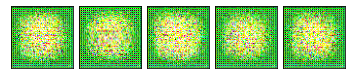

--- EPOCH 2/100 ---
100%|██████████| 34/34 [00:07<00:00,  4.61it/s]
Discriminator loss: 0.0024491760003216125
Generator loss:     9.506542037515079


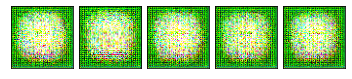

--- EPOCH 3/100 ---
100%|██████████| 34/34 [00:07<00:00,  4.60it/s]
Discriminator loss: 0.039392942288780916
Generator loss:     14.759795090731453


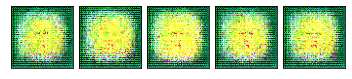

--- EPOCH 4/100 ---
100%|██████████| 34/34 [00:07<00:00,  4.57it/s]
Discriminator loss: -0.00026424886549220364
Generator loss:     23.485443760367


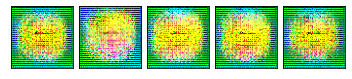

--- EPOCH 5/100 ---
100%|██████████| 34/34 [00:07<00:00,  4.58it/s]
Discriminator loss: 0.02634910510524231
Generator loss:     16.909704643137314
Saved checkpoint.


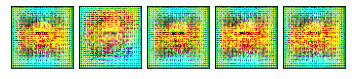

--- EPOCH 6/100 ---
100%|██████████| 34/34 [00:07<00:00,  4.60it/s]
Discriminator loss: 0.028216389939188957
Generator loss:     13.796740307527429
Saved checkpoint.


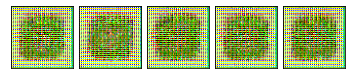

--- EPOCH 7/100 ---
100%|██████████| 34/34 [00:07<00:00,  4.55it/s]
Discriminator loss: -0.000635800335337134
Generator loss:     20.03824482244604


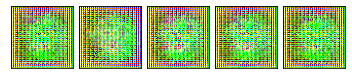

--- EPOCH 8/100 ---
100%|██████████| 34/34 [00:07<00:00,  4.61it/s]
Discriminator loss: 0.02866857170182116
Generator loss:     16.72885288911707
Saved checkpoint.


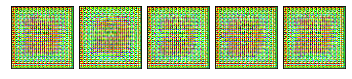

--- EPOCH 9/100 ---
100%|██████████| 34/34 [00:07<00:00,  4.55it/s]
Discriminator loss: 0.04513553321799811
Generator loss:     25.110559351303998


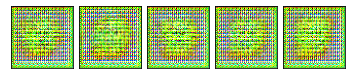

--- EPOCH 10/100 ---
100%|██████████| 34/34 [00:07<00:00,  4.58it/s]
Discriminator loss: -0.010176249177140348
Generator loss:     30.4387443486382


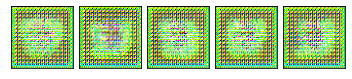

--- EPOCH 11/100 ---
100%|██████████| 34/34 [00:07<00:00,  4.54it/s]
Discriminator loss: -0.11698856412926141
Generator loss:     28.672185505137723
Saved checkpoint.


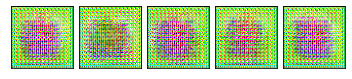

--- EPOCH 12/100 ---
100%|██████████| 34/34 [00:07<00:00,  4.53it/s]
Discriminator loss: 0.009274830712991603
Generator loss:     21.022841159035178
Saved checkpoint.


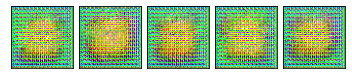

--- EPOCH 13/100 ---
100%|██████████| 34/34 [00:07<00:00,  4.58it/s]
Discriminator loss: -0.0632320666576133
Generator loss:     36.75363910899443


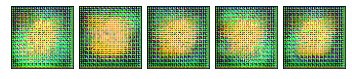

--- EPOCH 14/100 ---
100%|██████████| 34/34 [00:07<00:00,  4.51it/s]
Discriminator loss: -0.023330240893889877
Generator loss:     20.011306902941534
Saved checkpoint.


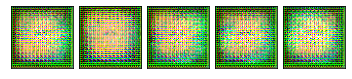

--- EPOCH 15/100 ---
100%|██████████| 34/34 [00:07<00:00,  4.55it/s]
Discriminator loss: 0.01245429038124926
Generator loss:     28.491005897521973


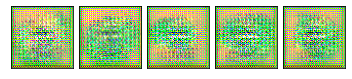

--- EPOCH 16/100 ---
100%|██████████| 34/34 [00:07<00:00,  4.54it/s]
Discriminator loss: 0.06411981012891321
Generator loss:     39.06060956506168


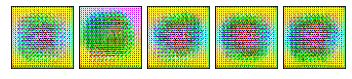

--- EPOCH 17/100 ---
100%|██████████| 34/34 [00:07<00:00,  4.58it/s]
Discriminator loss: -0.06699019549962353
Generator loss:     45.11565472097958


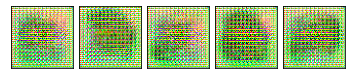

--- EPOCH 18/100 ---
100%|██████████| 34/34 [00:07<00:00,  4.54it/s]
Discriminator loss: -0.008947255637715845
Generator loss:     21.581153729382685
Saved checkpoint.


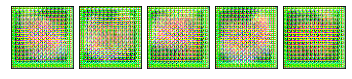

--- EPOCH 19/100 ---
100%|██████████| 34/34 [00:07<00:00,  4.56it/s]
Discriminator loss: -0.0742415779215448
Generator loss:     21.104756046743955
Saved checkpoint.


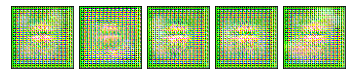

--- EPOCH 20/100 ---
100%|██████████| 34/34 [00:07<00:00,  4.54it/s]
Discriminator loss: 0.034894332508830464
Generator loss:     49.22295247807222


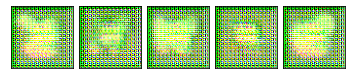

--- EPOCH 21/100 ---
100%|██████████| 34/34 [00:07<00:00,  4.52it/s]
Discriminator loss: 0.0007229971096796147
Generator loss:     40.74828534967759
Saved checkpoint.


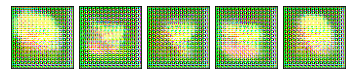

--- EPOCH 22/100 ---
100%|██████████| 34/34 [00:07<00:00,  4.53it/s]
Discriminator loss: 0.014268584001590224
Generator loss:     25.46211740549873
Saved checkpoint.


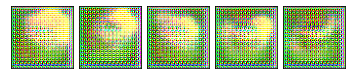

--- EPOCH 23/100 ---
100%|██████████| 34/34 [00:07<00:00,  4.48it/s]
Discriminator loss: 0.09172679023707614
Generator loss:     34.01522743000704


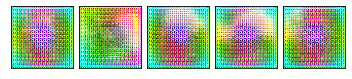

--- EPOCH 24/100 ---
100%|██████████| 34/34 [00:07<00:00,  4.51it/s]
Discriminator loss: -0.02267721076222027
Generator loss:     19.396435765659106
Saved checkpoint.


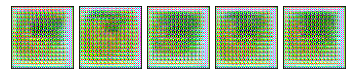

--- EPOCH 25/100 ---
100%|██████████| 34/34 [00:07<00:00,  4.51it/s]
Discriminator loss: 0.0015329733929213356
Generator loss:     17.102558893315933
Saved checkpoint.


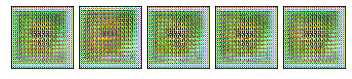

--- EPOCH 26/100 ---
100%|██████████| 34/34 [00:07<00:00,  4.51it/s]
Discriminator loss: -0.020146628293920967
Generator loss:     54.32417594685274


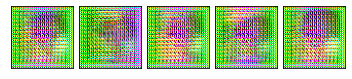

--- EPOCH 27/100 ---
100%|██████████| 34/34 [00:07<00:00,  4.52it/s]
Discriminator loss: -0.01680739618399564
Generator loss:     30.5965918933644
Saved checkpoint.


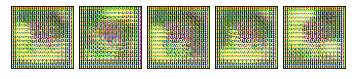

--- EPOCH 28/100 ---
100%|██████████| 34/34 [00:07<00:00,  4.50it/s]
Discriminator loss: 0.2829735081862001
Generator loss:     27.624615837545957
Saved checkpoint.


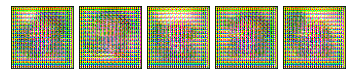

--- EPOCH 29/100 ---
100%|██████████| 34/34 [00:07<00:00,  4.49it/s]
Discriminator loss: 0.06771796941757202
Generator loss:     28.869695775649127


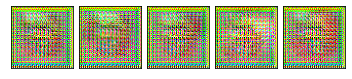

--- EPOCH 30/100 ---
100%|██████████| 34/34 [00:07<00:00,  4.51it/s]
Discriminator loss: -0.09585741469088722
Generator loss:     45.235214345595416


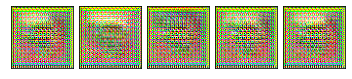

--- EPOCH 31/100 ---
100%|██████████| 34/34 [00:07<00:00,  4.52it/s]
Discriminator loss: 0.1817390530863229
Generator loss:     47.25440861197079


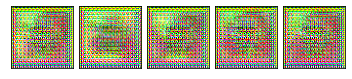

--- EPOCH 32/100 ---
100%|██████████| 34/34 [00:07<00:00,  4.54it/s]
Discriminator loss: 0.0725881650167353
Generator loss:     31.28894219678991
Saved checkpoint.


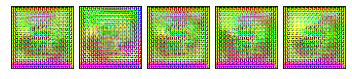

--- EPOCH 33/100 ---
100%|██████████| 34/34 [00:07<00:00,  4.53it/s]
Discriminator loss: 0.02803180761197034
Generator loss:     23.84570946412928
Saved checkpoint.


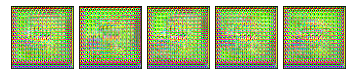

--- EPOCH 34/100 ---
100%|██████████| 34/34 [00:07<00:00,  4.52it/s]
Discriminator loss: -0.07202033676645335
Generator loss:     49.805345366982856


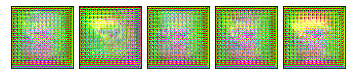

--- EPOCH 35/100 ---
100%|██████████| 34/34 [00:07<00:00,  4.49it/s]
Discriminator loss: 0.1719273353981621
Generator loss:     16.946341149947223
Saved checkpoint.


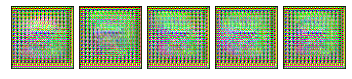

--- EPOCH 36/100 ---
100%|██████████| 34/34 [00:07<00:00,  4.51it/s]
Discriminator loss: 0.02235192104297526
Generator loss:     45.51519525752348


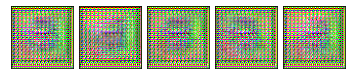

--- EPOCH 37/100 ---
100%|██████████| 34/34 [00:07<00:00,  4.52it/s]
Discriminator loss: -0.09890056007048663
Generator loss:     75.49805136287914


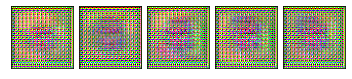

--- EPOCH 38/100 ---
100%|██████████| 34/34 [00:07<00:00,  4.51it/s]
Discriminator loss: -0.03029123562223771
Generator loss:     38.23626983866972
Saved checkpoint.


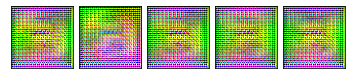

--- EPOCH 39/100 ---
100%|██████████| 34/34 [00:07<00:00,  4.52it/s]
Discriminator loss: 0.02072320703197928
Generator loss:     47.133000934825226


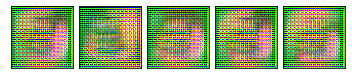

--- EPOCH 40/100 ---
100%|██████████| 34/34 [00:07<00:00,  4.52it/s]
Discriminator loss: 0.012752097538288902
Generator loss:     52.364662394804114


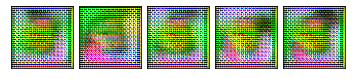

--- EPOCH 41/100 ---
100%|██████████| 34/34 [00:07<00:00,  4.56it/s]
Discriminator loss: -0.08086732139482218
Generator loss:     56.286776935353


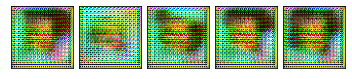

--- EPOCH 42/100 ---
100%|██████████| 34/34 [00:07<00:00,  4.52it/s]
Discriminator loss: -0.09786329725209404
Generator loss:     55.63587772144991
Saved checkpoint.


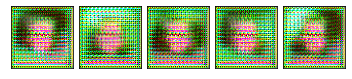

--- EPOCH 43/100 ---
100%|██████████| 34/34 [00:07<00:00,  4.49it/s]
Discriminator loss: -0.004323126857771593
Generator loss:     42.175593095667224
Saved checkpoint.


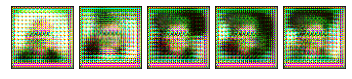

--- EPOCH 44/100 ---
100%|██████████| 34/34 [00:07<00:00,  4.55it/s]
Discriminator loss: 0.0347640062956249
Generator loss:     41.63322022381951
Saved checkpoint.


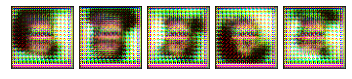

--- EPOCH 45/100 ---
100%|██████████| 34/34 [00:07<00:00,  4.56it/s]
Discriminator loss: -0.1564986366121208
Generator loss:     52.442653712104345


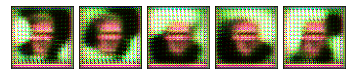

--- EPOCH 46/100 ---
100%|██████████| 34/34 [00:07<00:00,  4.54it/s]
Discriminator loss: 0.055924670003792816
Generator loss:     65.49192826888141


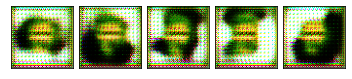

--- EPOCH 47/100 ---
100%|██████████| 34/34 [00:07<00:00,  4.55it/s]
Discriminator loss: 0.005649432978209327
Generator loss:     60.28794737423168
Saved checkpoint.


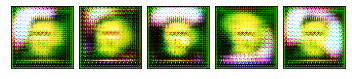

--- EPOCH 48/100 ---
100%|██████████| 34/34 [00:07<00:00,  4.52it/s]
Discriminator loss: 0.03738869463696199
Generator loss:     51.021423395942236
Saved checkpoint.


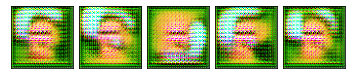

--- EPOCH 49/100 ---
100%|██████████| 34/34 [00:07<00:00,  4.57it/s]
Discriminator loss: 0.07025812347145642
Generator loss:     50.010756099925324
Saved checkpoint.


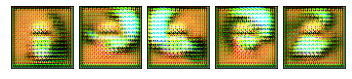

--- EPOCH 50/100 ---
100%|██████████| 34/34 [00:07<00:00,  4.59it/s]
Discriminator loss: 0.06808342039585114
Generator loss:     36.965616282294775
Saved checkpoint.


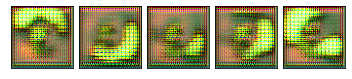

--- EPOCH 51/100 ---
100%|██████████| 34/34 [00:07<00:00,  4.56it/s]
Discriminator loss: 0.04319713001742082
Generator loss:     58.512705746818995


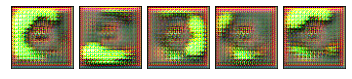

--- EPOCH 52/100 ---
100%|██████████| 34/34 [00:07<00:00,  4.57it/s]
Discriminator loss: 0.03442243892042076
Generator loss:     32.38716708912569
Saved checkpoint.


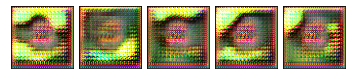

--- EPOCH 53/100 ---
100%|██████████| 34/34 [00:07<00:00,  4.58it/s]
Discriminator loss: 0.16701020453782642
Generator loss:     63.681119890774


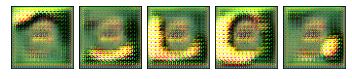

--- EPOCH 54/100 ---
100%|██████████| 34/34 [00:07<00:00,  4.60it/s]
Discriminator loss: 0.1068665433455916
Generator loss:     53.726496415979724
Saved checkpoint.


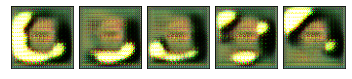

--- EPOCH 55/100 ---
100%|██████████| 34/34 [00:07<00:00,  4.57it/s]
Discriminator loss: 0.03233640399925849
Generator loss:     25.878284706788904
Saved checkpoint.


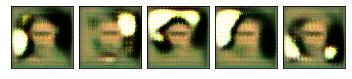

--- EPOCH 56/100 ---
100%|██████████| 34/34 [00:07<00:00,  4.54it/s]
Discriminator loss: 0.07140722936567138
Generator loss:     36.41165281744564


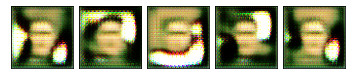

--- EPOCH 57/100 ---
100%|██████████| 34/34 [00:07<00:00,  4.46it/s]
Discriminator loss: 0.12741836554863872
Generator loss:     23.691817984861487
Saved checkpoint.


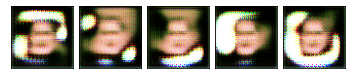

--- EPOCH 58/100 ---
100%|██████████| 34/34 [00:07<00:00,  4.54it/s]
Discriminator loss: -0.10289395403336077
Generator loss:     30.81535305696375


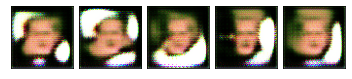

--- EPOCH 59/100 ---
100%|██████████| 34/34 [00:07<00:00,  4.53it/s]
Discriminator loss: 0.2823135383865413
Generator loss:     39.700804093304804


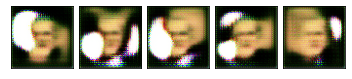

--- EPOCH 60/100 ---
100%|██████████| 34/34 [00:07<00:00,  4.52it/s]
Discriminator loss: 0.0365131902782356
Generator loss:     23.97009905646829
Saved checkpoint.


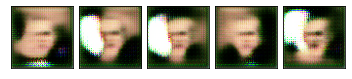

--- EPOCH 61/100 ---
100%|██████████| 34/34 [00:07<00:00,  4.56it/s]
Discriminator loss: -0.09766106263679616
Generator loss:     21.865016853108127
Saved checkpoint.


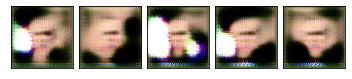

--- EPOCH 62/100 ---
100%|██████████| 34/34 [00:07<00:00,  4.56it/s]
Discriminator loss: 0.2692949973485049
Generator loss:     29.759865592507754


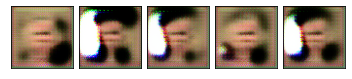

--- EPOCH 63/100 ---
100%|██████████| 34/34 [00:07<00:00,  4.56it/s]
Discriminator loss: 0.09544456531019772
Generator loss:     29.228280404034784
Saved checkpoint.


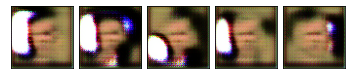

--- EPOCH 64/100 ---
100%|██████████| 34/34 [00:07<00:00,  4.54it/s]
Discriminator loss: 0.1650581944952993
Generator loss:     22.157755711499384
Saved checkpoint.


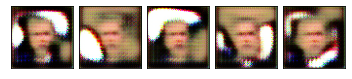

--- EPOCH 65/100 ---
100%|██████████| 34/34 [00:07<00:00,  4.56it/s]
Discriminator loss: 0.009513954029363744
Generator loss:     16.792897981755875
Saved checkpoint.


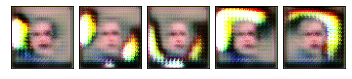

--- EPOCH 66/100 ---
100%|██████████| 34/34 [00:07<00:00,  4.56it/s]
Discriminator loss: 0.08268039459910463
Generator loss:     26.37819284551284


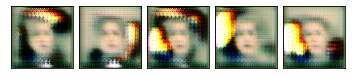

--- EPOCH 67/100 ---
100%|██████████| 34/34 [00:07<00:00,  4.52it/s]
Discriminator loss: -0.0337317283539211
Generator loss:     21.59854964648976
Saved checkpoint.


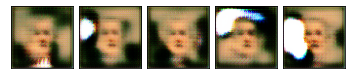

--- EPOCH 68/100 ---
100%|██████████| 34/34 [00:07<00:00,  4.53it/s]
Discriminator loss: 0.09959334639065406
Generator loss:     23.08104153240428


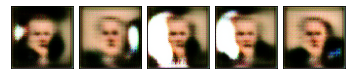

--- EPOCH 69/100 ---
100%|██████████| 34/34 [00:07<00:00,  4.56it/s]
Discriminator loss: 0.09376403733211405
Generator loss:     22.097585790297565
Saved checkpoint.


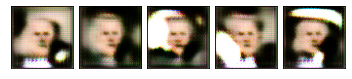

--- EPOCH 70/100 ---
100%|██████████| 34/34 [00:07<00:00,  4.53it/s]
Discriminator loss: 0.14057394149987137
Generator loss:     24.39111901732052


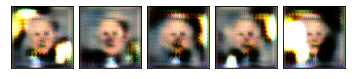

--- EPOCH 71/100 ---
100%|██████████| 34/34 [00:07<00:00,  4.54it/s]
Discriminator loss: 0.04248508920564371
Generator loss:     19.056193155400894
Saved checkpoint.


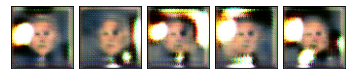

--- EPOCH 72/100 ---
100%|██████████| 34/34 [00:07<00:00,  4.56it/s]
Discriminator loss: 0.10528435821042341
Generator loss:     25.69146770589492


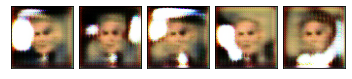

--- EPOCH 73/100 ---
100%|██████████| 34/34 [00:07<00:00,  4.60it/s]
Discriminator loss: 0.00012863449314061333
Generator loss:     17.330058322233313
Saved checkpoint.


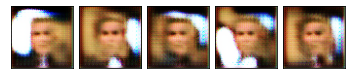

--- EPOCH 74/100 ---
100%|██████████| 34/34 [00:07<00:00,  4.59it/s]
Discriminator loss: 0.1576132466468741
Generator loss:     22.11055346096263


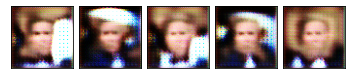

--- EPOCH 75/100 ---
100%|██████████| 34/34 [00:07<00:00,  4.59it/s]
Discriminator loss: 0.05464702976100585
Generator loss:     21.770633963977588
Saved checkpoint.


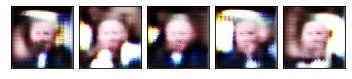

--- EPOCH 76/100 ---
100%|██████████| 34/34 [00:07<00:00,  4.59it/s]
Discriminator loss: -0.01730799751684946
Generator loss:     16.441869286929858
Saved checkpoint.


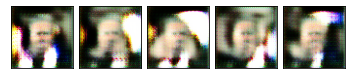

--- EPOCH 77/100 ---
100%|██████████| 34/34 [00:07<00:00,  4.59it/s]
Discriminator loss: 0.08282013938707464
Generator loss:     17.89191717260024


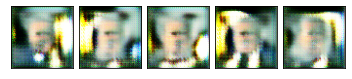

--- EPOCH 78/100 ---
100%|██████████| 34/34 [00:07<00:00,  4.58it/s]
Discriminator loss: 0.0791597486309269
Generator loss:     20.901334958917953


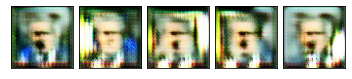

--- EPOCH 79/100 ---
100%|██████████| 34/34 [00:07<00:00,  4.57it/s]
Discriminator loss: 0.07239597433191888
Generator loss:     21.18618380322176


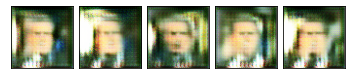

--- EPOCH 80/100 ---
100%|██████████| 34/34 [00:07<00:00,  4.50it/s]
Discriminator loss: 0.23152197119505966
Generator loss:     20.415704853394452
Saved checkpoint.


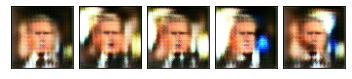

--- EPOCH 81/100 ---
100%|██████████| 34/34 [00:07<00:00,  4.60it/s]
Discriminator loss: 0.11092755198478699
Generator loss:     17.623043060302734
Saved checkpoint.


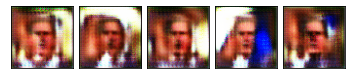

--- EPOCH 82/100 ---
100%|██████████| 34/34 [00:07<00:00,  4.60it/s]
Discriminator loss: -0.017364251810838196
Generator loss:     16.251925244050867
Saved checkpoint.


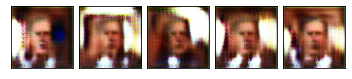

--- EPOCH 83/100 ---
100%|██████████| 34/34 [00:07<00:00,  4.60it/s]
Discriminator loss: 0.13124606862445087
Generator loss:     19.324434210272397


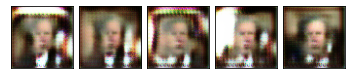

--- EPOCH 84/100 ---
100%|██████████| 34/34 [00:07<00:00,  4.56it/s]
Discriminator loss: -0.039575711769216204
Generator loss:     15.406809719169841
Saved checkpoint.


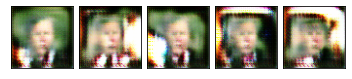

--- EPOCH 85/100 ---
100%|██████████| 34/34 [00:07<00:00,  4.58it/s]
Discriminator loss: 0.11400399828220115
Generator loss:     27.73977748085471


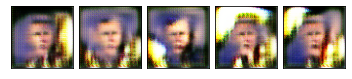

--- EPOCH 86/100 ---
100%|██████████| 34/34 [00:07<00:00,  4.56it/s]
Discriminator loss: 0.14191141505451763
Generator loss:     27.355035669663373
Saved checkpoint.


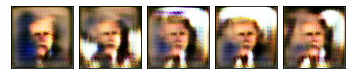

--- EPOCH 87/100 ---
100%|██████████| 34/34 [00:07<00:00,  4.60it/s]
Discriminator loss: 0.028893280007383403
Generator loss:     18.689270356122186
Saved checkpoint.


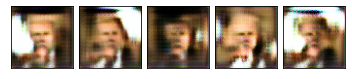

--- EPOCH 88/100 ---
100%|██████████| 34/34 [00:07<00:00,  4.59it/s]
Discriminator loss: 0.07722508107476375
Generator loss:     15.674895496929393
Saved checkpoint.


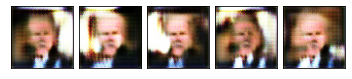

--- EPOCH 89/100 ---
100%|██████████| 34/34 [00:07<00:00,  4.58it/s]
Discriminator loss: 0.1210010458222207
Generator loss:     21.446273551267737


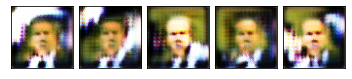

--- EPOCH 90/100 ---
100%|██████████| 34/34 [00:07<00:00,  4.58it/s]
Discriminator loss: 0.031076656106640312
Generator loss:     21.283454137689926
Saved checkpoint.


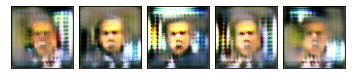

--- EPOCH 91/100 ---
100%|██████████| 34/34 [00:07<00:00,  4.54it/s]
Discriminator loss: 0.05041192607570659
Generator loss:     27.653613328933716


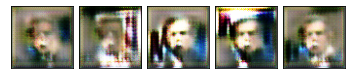

--- EPOCH 92/100 ---
100%|██████████| 34/34 [00:07<00:00,  4.56it/s]
Discriminator loss: 0.029064725098364493
Generator loss:     29.239655831280878


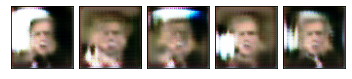

--- EPOCH 93/100 ---
100%|██████████| 34/34 [00:07<00:00,  4.53it/s]
Discriminator loss: -0.04153106115101015
Generator loss:     16.798023840960333
Saved checkpoint.


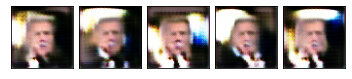

--- EPOCH 94/100 ---
100%|██████████| 34/34 [00:07<00:00,  4.57it/s]
Discriminator loss: 0.02102807558634702
Generator loss:     20.483413584092084


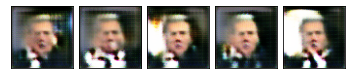

--- EPOCH 95/100 ---
100%|██████████| 34/34 [00:07<00:00,  4.56it/s]
Discriminator loss: -0.0189703501870527
Generator loss:     20.43014315997853
Saved checkpoint.


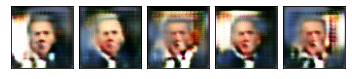

--- EPOCH 96/100 ---
100%|██████████| 34/34 [00:07<00:00,  4.58it/s]
Discriminator loss: -0.05063366692732362
Generator loss:     20.634971324135275


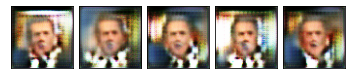

--- EPOCH 97/100 ---
100%|██████████| 34/34 [00:07<00:00,  4.55it/s]
Discriminator loss: 0.05019711927675149
Generator loss:     19.753578578724582
Saved checkpoint.


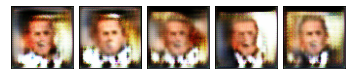

--- EPOCH 98/100 ---
100%|██████████| 34/34 [00:07<00:00,  4.57it/s]
Discriminator loss: -0.010016090729657342
Generator loss:     15.044782722697539
Saved checkpoint.


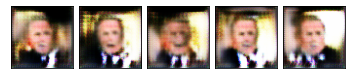

--- EPOCH 99/100 ---
100%|██████████| 34/34 [00:07<00:00,  4.59it/s]
Discriminator loss: 0.07157205746454351
Generator loss:     17.829791938557346


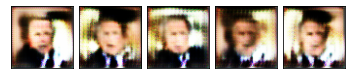

--- EPOCH 100/100 ---
100%|██████████| 34/34 [00:07<00:00,  4.60it/s]
Discriminator loss: 0.11873163260957774
Generator loss:     18.300586223602295


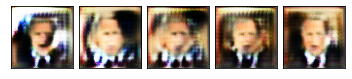

In [2]:
num_epochs = 100

if os.path.isfile(f'{checkpoint_file_final}.pt'):
    print(f'*** Loading final checkpoint file {checkpoint_file_final} instead of training')
    num_epochs = 0
    gen = torch.load(f'{checkpoint_file_final}.pt', map_location=device)
    checkpoint_file = checkpoint_file_final

try:
    dsc_avg_losses, gen_avg_losses = [], []
    for epoch_idx in range(num_epochs):
        # We'll accumulate batch losses and show an average once per epoch.
        dsc_losses, gen_losses = [], []
        print(f'--- EPOCH {epoch_idx+1}/{num_epochs} ---')

        with tqdm.tqdm(total=len(dl_train.batch_sampler), file=sys.stdout) as pbar:
            for batch_idx, (x_data, _) in enumerate(dl_train):
                x_data = x_data.to(device)
                dsc_loss, gen_loss = train_batch(
                    dsc, gen,
                    dsc_loss_fn, gen_loss_fn,
                    dsc_optimizer, gen_optimizer,
                    x_data)
                dsc_losses.append(dsc_loss)
                gen_losses.append(gen_loss)
                pbar.update()

        dsc_avg_losses.append(np.mean(dsc_losses))
        gen_avg_losses.append(np.mean(gen_losses))
        print(f'Discriminator loss: {dsc_avg_losses[-1]}')
        print(f'Generator loss:     {gen_avg_losses[-1]}')
        
        if save_checkpoint(gen, dsc_avg_losses, gen_avg_losses, checkpoint_file):
            print(f'Saved checkpoint.')
            

        samples = gen.sample(5, with_grad=False)
        fig, _ = plot.tensors_as_images(samples.cpu(), figsize=(6,2))
        IPython.display.display(fig)
        plt.close(fig)
except KeyboardInterrupt as e:
    print('\n *** Training interrupted by user')

*** Images Generated from best model:


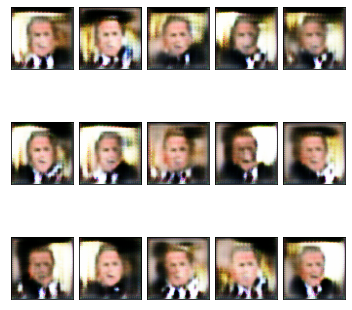

In [3]:
# Plot images from best or last model
if os.path.isfile(f'{checkpoint_file}.pt'):
    gen = torch.load(f'{checkpoint_file}.pt', map_location=device)
print('*** Images Generated from best model:')
samples = gen["model"].sample(n=15, with_grad=False).cpu()
fig, _ = plot.tensors_as_images(samples, nrows=3, figsize=(6,6))

In [4]:
## inception test TODO
from inception_s.inception_score import inception_score

mean, std = inception_score(samples, cuda=device,batch_size=5,resize=True, splits=1)
print("mean:", mean)
print("std:", std)
file = open("temp/stat.txt", 'w')
file.write(str(mean)+' '+str(std) + '\n')
file.close()

mean: 1.747478628216551
std: 0.0


/home/tok/miniconda3/envs/cs236781-hw/lib/python3.8/site-packages/torch/nn/functional.py:3118: UserWarning: Default upsampling behavior when mode=bilinear is changed to align_corners=False since 0.4.0. Please specify align_corners=True if the old behavior is desired. See the documentation of nn.Upsample for details.
  warnings.warn("Default upsampling behavior when mode={} is changed "
/home/tok/mini_project_GAN/inception_s/inception_score.py:44: UserWarning: Implicit dimension choice for softmax has been deprecated. Change the call to include dim=X as an argument.
  return F.softmax(x).data.cpu().numpy()


In [5]:
# save images
from torchvision.utils import save_image

N = 15
baseName = "samples/vanilla/Sample_GAN_Vanilla_"
for i in range(N):
    save_image(samples[i], baseName+str(i)+".png")

In [6]:
## SNGAN

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload
Using device: cuda
File /home/tok/.pytorch-datasets/lfw-bush.zip exists, skipping download.
Extracting /home/tok/.pytorch-datasets/lfw-bush.zip...
Extracted 531 to /home/tok/.pytorch-datasets/lfw/George_W_Bush
{'batch_size': 4, 'z_dim': 64, 'data_label': 1, 'label_noise': 0.5, 'discriminator_optimizer': {'type': 'Adam', 'lr': 0.01}, 'generator_optimizer': {'type': 'Adam', 'lr': 1e-05}}
--- EPOCH 1/100 ---
100%|██████████| 133/133 [00:12<00:00, 10.91it/s]
Discriminator loss: 0.5705519314099076
Generator loss:     2.6477173931451485
Saved checkpoint.


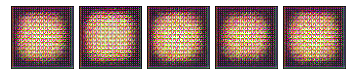

--- EPOCH 2/100 ---
100%|██████████| 133/133 [00:12<00:00, 10.91it/s]
Discriminator loss: 0.33689448349457934
Generator loss:     16.127435092639207


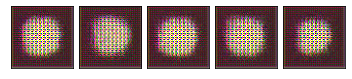

--- EPOCH 3/100 ---
100%|██████████| 133/133 [00:12<00:00, 10.92it/s]
Discriminator loss: 0.23654321978863022
Generator loss:     14.288842084712552
Saved checkpoint.


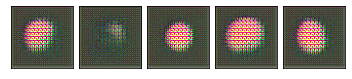

--- EPOCH 4/100 ---
100%|██████████| 133/133 [00:12<00:00, 10.91it/s]
Discriminator loss: 0.2658262407701266
Generator loss:     6.052762334508107
Saved checkpoint.


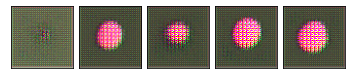

--- EPOCH 5/100 ---
100%|██████████| 133/133 [00:12<00:00, 10.93it/s]
Discriminator loss: 0.09015620555868722
Generator loss:     5.886318886190429
Saved checkpoint.


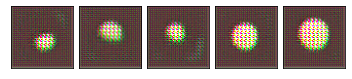

--- EPOCH 6/100 ---
100%|██████████| 133/133 [00:12<00:00, 10.92it/s]
Discriminator loss: 0.09567164217955187
Generator loss:     4.816491922937837
Saved checkpoint.


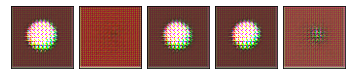

--- EPOCH 7/100 ---
100%|██████████| 133/133 [00:12<00:00, 10.88it/s]
Discriminator loss: -0.0274220167806274
Generator loss:     5.3507768773942965


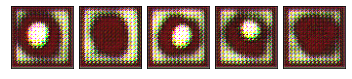

--- EPOCH 8/100 ---
100%|██████████| 133/133 [00:12<00:00, 10.96it/s]
Discriminator loss: 0.2400422766244501
Generator loss:     3.049444253283336
Saved checkpoint.


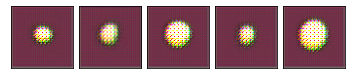

--- EPOCH 9/100 ---
100%|██████████| 133/133 [00:12<00:00, 10.91it/s]
Discriminator loss: 0.4926786232823716
Generator loss:     3.9030176493010127


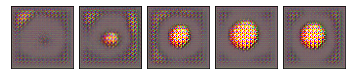

--- EPOCH 10/100 ---
100%|██████████| 133/133 [00:12<00:00, 10.93it/s]
Discriminator loss: 0.3776915035301581
Generator loss:     2.268830350467137
Saved checkpoint.


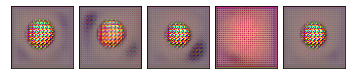

--- EPOCH 11/100 ---
100%|██████████| 133/133 [00:12<00:00, 10.87it/s]
Discriminator loss: 0.6980989689105436
Generator loss:     2.01777396726429


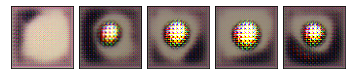

--- EPOCH 12/100 ---
100%|██████████| 133/133 [00:12<00:00, 10.81it/s]
Discriminator loss: 0.40457154956079067
Generator loss:     2.904938376487646


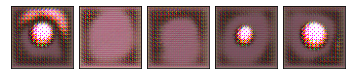

--- EPOCH 13/100 ---
100%|██████████| 133/133 [00:12<00:00, 10.93it/s]
Discriminator loss: 0.7135694792172066
Generator loss:     3.4395411677826617


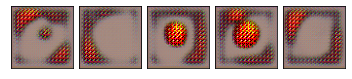

--- EPOCH 14/100 ---
100%|██████████| 133/133 [00:12<00:00, 10.93it/s]
Discriminator loss: 0.6575723766608346
Generator loss:     3.8118070455870234


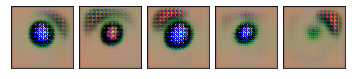

--- EPOCH 15/100 ---
100%|██████████| 133/133 [00:12<00:00, 10.93it/s]
Discriminator loss: 0.6944293820096138
Generator loss:     3.2427294135541844
Saved checkpoint.


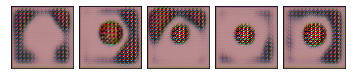

--- EPOCH 16/100 ---
100%|██████████| 133/133 [00:12<00:00, 10.85it/s]
Discriminator loss: 0.37528520452796965
Generator loss:     2.344007125698534
Saved checkpoint.


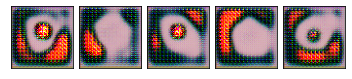

--- EPOCH 17/100 ---
100%|██████████| 133/133 [00:12<00:00, 10.73it/s]
Discriminator loss: 0.7515804280239836
Generator loss:     1.8421289250814825
Saved checkpoint.


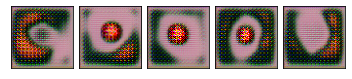

--- EPOCH 18/100 ---
100%|██████████| 133/133 [00:12<00:00, 10.89it/s]
Discriminator loss: 1.1364542202729928
Generator loss:     1.339255206118849
Saved checkpoint.


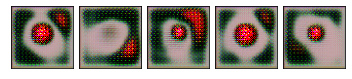

--- EPOCH 19/100 ---
100%|██████████| 133/133 [00:12<00:00, 10.90it/s]
Discriminator loss: 0.5013959521245688
Generator loss:     1.851124335276453
Saved checkpoint.


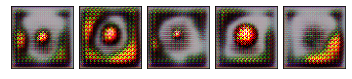

--- EPOCH 20/100 ---
100%|██████████| 133/133 [00:12<00:00, 10.91it/s]
Discriminator loss: 0.7961099678300377
Generator loss:     1.9540309585574875


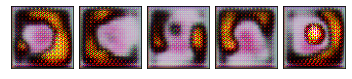

--- EPOCH 21/100 ---
100%|██████████| 133/133 [00:12<00:00, 10.94it/s]
Discriminator loss: 0.6222493411566978
Generator loss:     1.8588576462483943
Saved checkpoint.


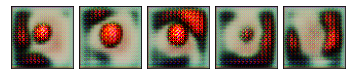

--- EPOCH 22/100 ---
100%|██████████| 133/133 [00:12<00:00, 10.89it/s]
Discriminator loss: 0.5199635009792515
Generator loss:     2.7376020335613336


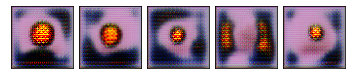

--- EPOCH 23/100 ---
100%|██████████| 133/133 [00:12<00:00, 10.92it/s]
Discriminator loss: 0.44548678400933295
Generator loss:     2.5828124387819966
Saved checkpoint.


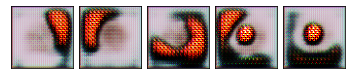

--- EPOCH 24/100 ---
100%|██████████| 133/133 [00:12<00:00, 10.95it/s]
Discriminator loss: 0.5389355130325583
Generator loss:     2.5914781564160396


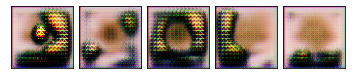

--- EPOCH 25/100 ---
100%|██████████| 133/133 [00:12<00:00, 10.91it/s]
Discriminator loss: 0.3397964043892864
Generator loss:     2.9188993420816005


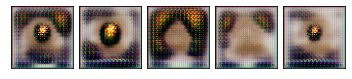

--- EPOCH 26/100 ---
100%|██████████| 133/133 [00:12<00:00, 10.96it/s]
Discriminator loss: 0.5452369143976304
Generator loss:     2.741238794086459


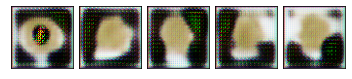

--- EPOCH 27/100 ---
100%|██████████| 133/133 [00:12<00:00, 10.79it/s]
Discriminator loss: 0.38428625362203983
Generator loss:     2.563504553827128
Saved checkpoint.


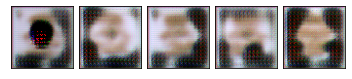

--- EPOCH 28/100 ---
100%|██████████| 133/133 [00:12<00:00, 10.67it/s]
Discriminator loss: 0.6238481325090379
Generator loss:     2.2494036904851296
Saved checkpoint.


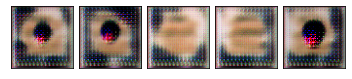

--- EPOCH 29/100 ---
100%|██████████| 133/133 [00:12<00:00, 10.66it/s]
Discriminator loss: 0.6002233498134559
Generator loss:     2.0963883269998362
Saved checkpoint.


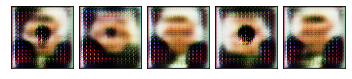

--- EPOCH 30/100 ---
100%|██████████| 133/133 [00:12<00:00, 10.62it/s]
Discriminator loss: 0.7092714758127704
Generator loss:     1.9800963598982733
Saved checkpoint.


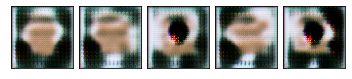

--- EPOCH 31/100 ---
100%|██████████| 133/133 [00:12<00:00, 10.64it/s]
Discriminator loss: 0.6652207483810589
Generator loss:     1.8823614301986265
Saved checkpoint.


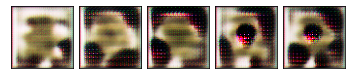

--- EPOCH 32/100 ---
100%|██████████| 133/133 [00:12<00:00, 10.65it/s]
Discriminator loss: 0.6768171732923142
Generator loss:     1.8221019956850468
Saved checkpoint.


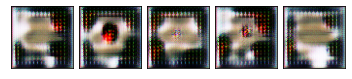

--- EPOCH 33/100 ---
100%|██████████| 133/133 [00:12<00:00, 10.63it/s]
Discriminator loss: 0.6116662038336123
Generator loss:     2.005430816371638


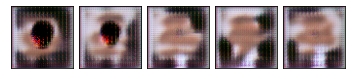

--- EPOCH 34/100 ---
100%|██████████| 133/133 [00:12<00:00, 10.63it/s]
Discriminator loss: 0.44762872898937167
Generator loss:     2.1297402157819363
Saved checkpoint.


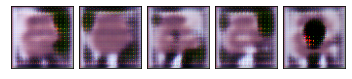

--- EPOCH 35/100 ---
100%|██████████| 133/133 [00:12<00:00, 10.67it/s]
Discriminator loss: 0.6732618241269785
Generator loss:     2.327992933137076


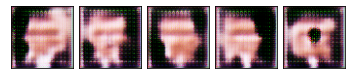

--- EPOCH 36/100 ---
100%|██████████| 133/133 [00:12<00:00, 10.50it/s]
Discriminator loss: 0.6421875780574361
Generator loss:     2.2169735700564277
Saved checkpoint.


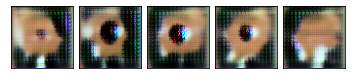

--- EPOCH 37/100 ---
100%|██████████| 133/133 [00:12<00:00, 10.64it/s]
Discriminator loss: 0.47126967756819904
Generator loss:     2.3788448800717976
Saved checkpoint.


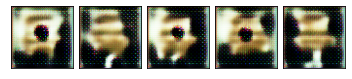

--- EPOCH 38/100 ---
100%|██████████| 133/133 [00:12<00:00, 10.56it/s]
Discriminator loss: 0.4279271343484857
Generator loss:     2.266702065342351
Saved checkpoint.


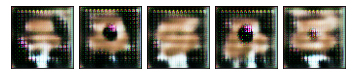

--- EPOCH 39/100 ---
100%|██████████| 133/133 [00:12<00:00, 10.48it/s]
Discriminator loss: 0.35478903891000535
Generator loss:     2.9116450971678685


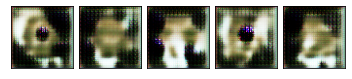

--- EPOCH 40/100 ---
100%|██████████| 133/133 [00:12<00:00, 10.51it/s]
Discriminator loss: 0.506776751964388
Generator loss:     2.64053002470418
Saved checkpoint.


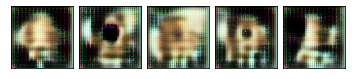

--- EPOCH 41/100 ---
100%|██████████| 133/133 [00:12<00:00, 10.52it/s]
Discriminator loss: 0.6267032540662396
Generator loss:     2.147329836859739
Saved checkpoint.


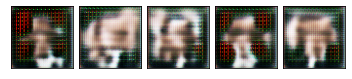

--- EPOCH 42/100 ---
100%|██████████| 133/133 [00:12<00:00, 10.51it/s]
Discriminator loss: 0.5814912119754275
Generator loss:     2.171722454235966
Saved checkpoint.


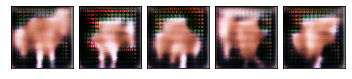

--- EPOCH 43/100 ---
100%|██████████| 133/133 [00:12<00:00, 10.54it/s]
Discriminator loss: 0.4773271811243735
Generator loss:     2.0964431762695312
Saved checkpoint.


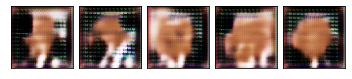

--- EPOCH 44/100 ---
100%|██████████| 133/133 [00:12<00:00, 10.47it/s]
Discriminator loss: 0.7284312130589234
Generator loss:     1.82732251512685
Saved checkpoint.


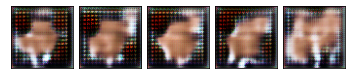

--- EPOCH 45/100 ---
100%|██████████| 133/133 [00:12<00:00, 10.57it/s]
Discriminator loss: 0.5888899801705116
Generator loss:     2.038433693853536


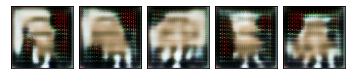

--- EPOCH 46/100 ---
100%|██████████| 133/133 [00:12<00:00, 10.47it/s]
Discriminator loss: 0.47903189802528323
Generator loss:     2.1624397604089034


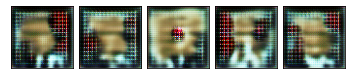

--- EPOCH 47/100 ---
100%|██████████| 133/133 [00:12<00:00, 10.38it/s]
Discriminator loss: 0.3379421842221479
Generator loss:     2.6958666475195634


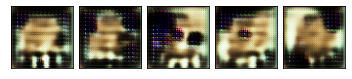

--- EPOCH 48/100 ---
100%|██████████| 133/133 [00:12<00:00, 10.49it/s]
Discriminator loss: 0.562954517907666
Generator loss:     2.6576973261465704


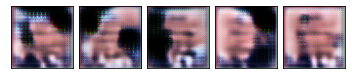

--- EPOCH 49/100 ---
100%|██████████| 133/133 [00:12<00:00, 10.53it/s]
Discriminator loss: 0.25867448693939615
Generator loss:     2.714516302248589
Saved checkpoint.


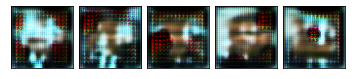

--- EPOCH 50/100 ---
100%|██████████| 133/133 [00:12<00:00, 10.53it/s]
Discriminator loss: 0.3415665554821043
Generator loss:     2.9473849230803046


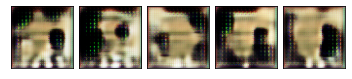

--- EPOCH 51/100 ---
100%|██████████| 133/133 [00:12<00:00, 10.48it/s]
Discriminator loss: 0.5068901932021057
Generator loss:     2.483356781920096
Saved checkpoint.


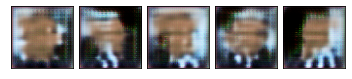

--- EPOCH 52/100 ---
100%|██████████| 133/133 [00:12<00:00, 10.52it/s]
Discriminator loss: 0.557276311589587
Generator loss:     2.399562525345867
Saved checkpoint.


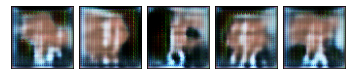

--- EPOCH 53/100 ---
100%|██████████| 133/133 [00:12<00:00, 10.52it/s]
Discriminator loss: 0.5156064881081868
Generator loss:     2.233628240519
Saved checkpoint.


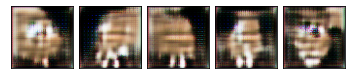

--- EPOCH 54/100 ---
100%|██████████| 133/133 [00:12<00:00, 10.50it/s]
Discriminator loss: 0.5320226341149861
Generator loss:     2.1543258205616382
Saved checkpoint.


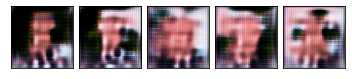

--- EPOCH 55/100 ---
100%|██████████| 133/133 [00:12<00:00, 10.50it/s]
Discriminator loss: 0.4952904819825986
Generator loss:     2.6375777560069147


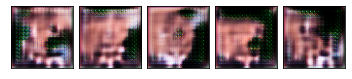

--- EPOCH 56/100 ---
100%|██████████| 133/133 [00:12<00:00, 10.52it/s]
Discriminator loss: 0.4303546798296441
Generator loss:     2.781344744047724


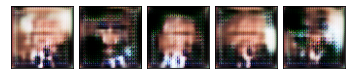

--- EPOCH 57/100 ---
100%|██████████| 133/133 [00:12<00:00, 10.46it/s]
Discriminator loss: 0.388441020664864
Generator loss:     2.877798683213112


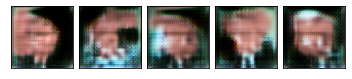

--- EPOCH 58/100 ---
100%|██████████| 133/133 [00:12<00:00, 10.54it/s]
Discriminator loss: 0.35363645761981044
Generator loss:     2.8492713660225832
Saved checkpoint.


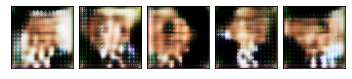

--- EPOCH 59/100 ---
100%|██████████| 133/133 [00:12<00:00, 10.56it/s]
Discriminator loss: 0.49510510341453373
Generator loss:     2.393942534475398
Saved checkpoint.


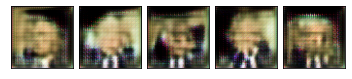

--- EPOCH 60/100 ---
100%|██████████| 133/133 [00:12<00:00, 10.62it/s]
Discriminator loss: 0.6047723916240204
Generator loss:     2.320812904296961


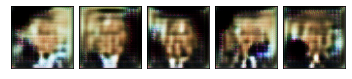

--- EPOCH 61/100 ---
100%|██████████| 133/133 [00:12<00:00, 10.60it/s]
Discriminator loss: 0.46757286618974875
Generator loss:     2.553475802330146


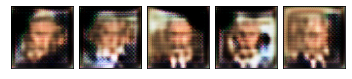

--- EPOCH 62/100 ---
100%|██████████| 133/133 [00:12<00:00, 10.63it/s]
Discriminator loss: 0.46708410930700767
Generator loss:     2.4411217140075854
Saved checkpoint.


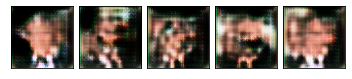

--- EPOCH 63/100 ---
100%|██████████| 133/133 [00:12<00:00, 10.60it/s]
Discriminator loss: 0.5910732517285007
Generator loss:     2.129357597433535
Saved checkpoint.


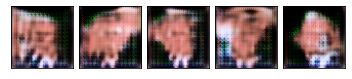

--- EPOCH 64/100 ---
100%|██████████| 133/133 [00:12<00:00, 10.62it/s]
Discriminator loss: 0.5138596192114335
Generator loss:     2.6501136538677645


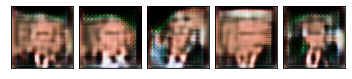

--- EPOCH 65/100 ---
100%|██████████| 133/133 [00:12<00:00, 10.62it/s]
Discriminator loss: 0.4258858200750853
Generator loss:     2.6101231969388805
Saved checkpoint.


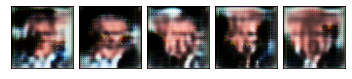

--- EPOCH 66/100 ---
100%|██████████| 133/133 [00:12<00:00, 10.58it/s]
Discriminator loss: 0.44407781521628675
Generator loss:     2.6163457197354254


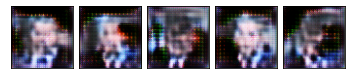

--- EPOCH 67/100 ---
100%|██████████| 133/133 [00:12<00:00, 10.62it/s]
Discriminator loss: 0.33614359252659004
Generator loss:     2.9523695227795077


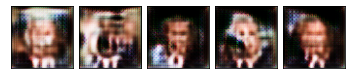

--- EPOCH 68/100 ---
100%|██████████| 133/133 [00:12<00:00, 10.64it/s]
Discriminator loss: 0.47439241431709517
Generator loss:     2.5810032448822393
Saved checkpoint.


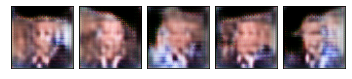

--- EPOCH 69/100 ---
100%|██████████| 133/133 [00:12<00:00, 10.46it/s]
Discriminator loss: 0.5093802832683226
Generator loss:     2.2654985547962045
Saved checkpoint.


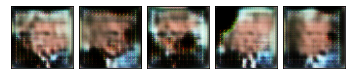

--- EPOCH 70/100 ---
100%|██████████| 133/133 [00:12<00:00, 10.52it/s]
Discriminator loss: 0.4323288222172655
Generator loss:     2.5228657664212966


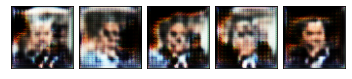

--- EPOCH 71/100 ---
100%|██████████| 133/133 [00:12<00:00, 10.55it/s]
Discriminator loss: 0.4130670624343972
Generator loss:     2.7236303055196776


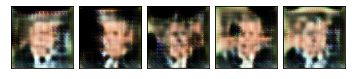

--- EPOCH 72/100 ---
100%|██████████| 133/133 [00:12<00:00, 10.49it/s]
Discriminator loss: 0.4187963980817257
Generator loss:     2.33156072465997
Saved checkpoint.


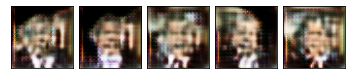

--- EPOCH 73/100 ---
100%|██████████| 133/133 [00:12<00:00, 10.49it/s]
Discriminator loss: 0.502741186578471
Generator loss:     2.494219779071951


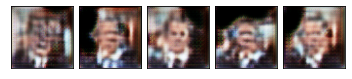

--- EPOCH 74/100 ---
100%|██████████| 133/133 [00:12<00:00, 10.53it/s]
Discriminator loss: 0.5142399611273655
Generator loss:     2.4290804376727655
Saved checkpoint.


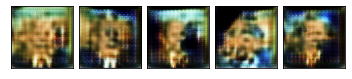

--- EPOCH 75/100 ---
100%|██████████| 133/133 [00:12<00:00, 10.46it/s]
Discriminator loss: 0.5327639183155576
Generator loss:     2.3508469484802474
Saved checkpoint.


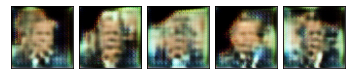

--- EPOCH 76/100 ---
100%|██████████| 133/133 [00:12<00:00, 10.51it/s]
Discriminator loss: 0.44418678768819436
Generator loss:     2.4522093498617186


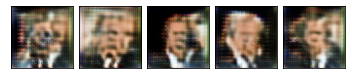

--- EPOCH 77/100 ---
100%|██████████| 133/133 [00:12<00:00, 10.52it/s]
Discriminator loss: 0.47206359093350575
Generator loss:     2.5094736505271795


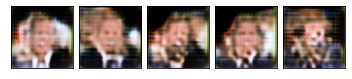

--- EPOCH 78/100 ---
100%|██████████| 133/133 [00:12<00:00, 10.53it/s]
Discriminator loss: 0.4982679684023212
Generator loss:     2.6514161065556947


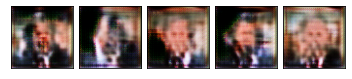

--- EPOCH 79/100 ---
100%|██████████| 133/133 [00:12<00:00, 10.50it/s]
Discriminator loss: 0.4908242961181734
Generator loss:     2.3406695356046345
Saved checkpoint.


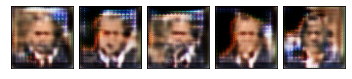

--- EPOCH 80/100 ---
100%|██████████| 133/133 [00:12<00:00, 10.50it/s]
Discriminator loss: 0.3865641410693638
Generator loss:     2.699262302396889


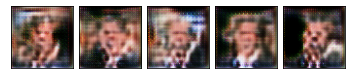

--- EPOCH 81/100 ---
100%|██████████| 133/133 [00:12<00:00, 10.46it/s]
Discriminator loss: 0.5054567313956139
Generator loss:     2.473211060565217
Saved checkpoint.


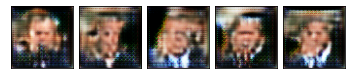

--- EPOCH 82/100 ---
100%|██████████| 133/133 [00:12<00:00, 10.54it/s]
Discriminator loss: 0.4325576387065694
Generator loss:     2.3669232248811793
Saved checkpoint.


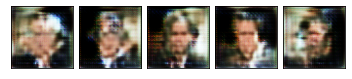

--- EPOCH 83/100 ---
100%|██████████| 133/133 [00:12<00:00, 10.49it/s]
Discriminator loss: 0.38344319806175126
Generator loss:     2.5597193079783502


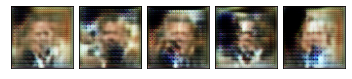

--- EPOCH 84/100 ---
100%|██████████| 133/133 [00:12<00:00, 10.54it/s]
Discriminator loss: 0.5388077317379919
Generator loss:     2.4581310430863748


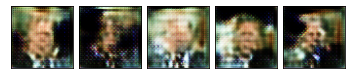

--- EPOCH 85/100 ---
100%|██████████| 133/133 [00:12<00:00, 10.64it/s]
Discriminator loss: 0.5167346786623611
Generator loss:     2.431492511042975
Saved checkpoint.


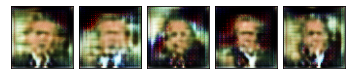

--- EPOCH 86/100 ---
100%|██████████| 133/133 [00:12<00:00, 10.59it/s]
Discriminator loss: 0.49721920212968845
Generator loss:     2.506088220647403


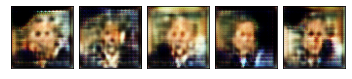

--- EPOCH 87/100 ---
100%|██████████| 133/133 [00:12<00:00, 10.63it/s]
Discriminator loss: 0.6288781295481481
Generator loss:     2.0133260273395623
Saved checkpoint.


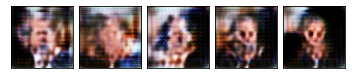

--- EPOCH 88/100 ---
100%|██████████| 133/133 [00:12<00:00, 10.62it/s]
Discriminator loss: 0.6351387276965424
Generator loss:     2.0974339103340207


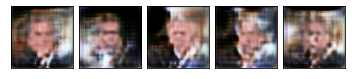

--- EPOCH 89/100 ---
100%|██████████| 133/133 [00:12<00:00, 10.63it/s]
Discriminator loss: 0.4441474096891575
Generator loss:     2.4148706715357933


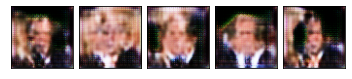

--- EPOCH 90/100 ---
100%|██████████| 133/133 [00:12<00:00, 10.58it/s]
Discriminator loss: 0.4225216961948943
Generator loss:     2.548740779995022


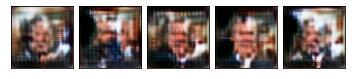

--- EPOCH 91/100 ---
100%|██████████| 133/133 [00:12<00:00, 10.59it/s]
Discriminator loss: 0.48449333852395077
Generator loss:     2.3846187627405153
Saved checkpoint.


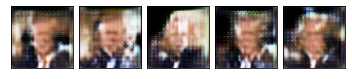

--- EPOCH 92/100 ---
100%|██████████| 133/133 [00:12<00:00, 10.42it/s]
Discriminator loss: 0.4472511338448166
Generator loss:     2.464123073489146


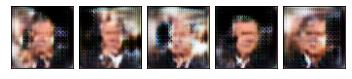

--- EPOCH 93/100 ---
100%|██████████| 133/133 [00:12<00:00, 10.66it/s]
Discriminator loss: 0.5210599992844395
Generator loss:     2.4490494118597272


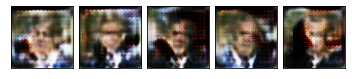

--- EPOCH 94/100 ---
100%|██████████| 133/133 [00:12<00:00, 10.66it/s]
Discriminator loss: 0.5740232845782337
Generator loss:     2.2067654728889465
Saved checkpoint.


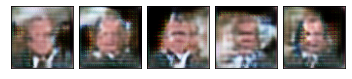

--- EPOCH 95/100 ---
100%|██████████| 133/133 [00:12<00:00, 10.63it/s]
Discriminator loss: 0.4623214094934607
Generator loss:     2.2511696564523795
Saved checkpoint.


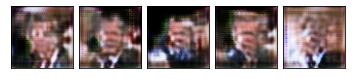

--- EPOCH 96/100 ---
100%|██████████| 133/133 [00:12<00:00, 10.59it/s]
Discriminator loss: 0.5921995591064145
Generator loss:     2.2465221653307292


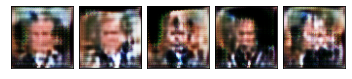

--- EPOCH 97/100 ---
100%|██████████| 133/133 [00:12<00:00, 10.47it/s]
Discriminator loss: 0.4672780987015344
Generator loss:     2.617949202544707


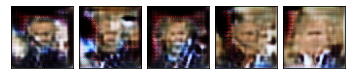

--- EPOCH 98/100 ---
100%|██████████| 133/133 [00:12<00:00, 10.59it/s]
Discriminator loss: 0.6349197590261474
Generator loss:     2.0042755552252434
Saved checkpoint.


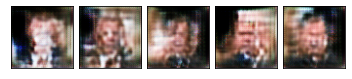

--- EPOCH 99/100 ---
100%|██████████| 133/133 [00:12<00:00, 10.62it/s]
Discriminator loss: 0.6208608065892879
Generator loss:     2.0066458851771247
Saved checkpoint.


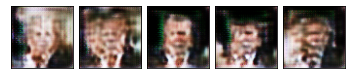

--- EPOCH 100/100 ---
100%|██████████| 133/133 [00:12<00:00, 10.62it/s]
Discriminator loss: 0.42619063632380694
Generator loss:     2.5031509847569287


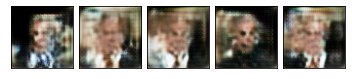

In [7]:
import unittest
import os
import sys
import pathlib
import urllib
import shutil
import re
import zipfile

import numpy as np
import torch
import matplotlib.pyplot as plt

%load_ext autoreload
%autoreload 2

test = unittest.TestCase()
plt.rcParams.update({'font.size': 12})
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
print('Using device:', device)


import project.cs236781.plot as plot
import project.cs236781.download
from project.hw3.answers import PART3_CUSTOM_DATA_URL as CUSTOM_DATA_URL

DATA_DIR = pathlib.Path.home().joinpath('.pytorch-datasets')
if CUSTOM_DATA_URL is None:
    DATA_URL = 'http://vis-www.cs.umass.edu/lfw/lfw-bush.zip'
else:
    DATA_URL = CUSTOM_DATA_URL

_, dataset_dir = project.cs236781.download.download_data(out_path=DATA_DIR, url=DATA_URL, extract=True, force=False)


import torchvision.transforms as T
from torchvision.datasets import ImageFolder

im_size = 64
tf = T.Compose([
    # Resize to constant spatial dimensions
    T.Resize((im_size, im_size)),
    # PIL.Image -> torch.Tensor
    T.ToTensor(),
    # Dynamic range [0,1] -> [-1, 1]
    T.Normalize(mean=(.5,.5,.5), std=(.5,.5,.5)),
])

ds_gwb = ImageFolder(os.path.dirname(dataset_dir), tf)

# _ = plot.dataset_first_n(ds_gwb, 50, figsize=(15,10), nrows=5)
# print(f'Found {len(ds_gwb)} images in dataset folder.')

x0, y0 = ds_gwb[0]
x0 = x0.unsqueeze(0).to(device)
# print(x0.shape)

test.assertSequenceEqual(x0.shape, (1, 3, im_size, im_size))


import project.hw3.gan_sn as gan

dsc = gan.Discriminator(in_size=x0[0].shape).to(device)
# print(dsc)

d0 = dsc(x0)
# print(d0.shape)

test.assertSequenceEqual(d0.shape, (1,1))


z_dim = 128
gen = gan.Generator(z_dim, 4).to(device)
# print(gen)

z = torch.randn(1, z_dim).to(device)
xr = gen(z)
# print(xr.shape)

test.assertSequenceEqual(x0.shape, xr.shape)


from project.hw3.gan_sn import discriminator_loss_fn
torch.manual_seed(42)

y_data = torch.rand(10) * 10
y_generated = torch.rand(10) * 10

loss = discriminator_loss_fn(y_data, y_generated, data_label=1, label_noise=0.3)
# print(loss)

test.assertAlmostEqual(loss.item(), 6.4808731, delta=1e-5)


from project.hw3.gan_sn import generator_loss_fn
torch.manual_seed(42)

y_generated = torch.rand(20) * 10

loss = generator_loss_fn(y_generated, data_label=1)
# print(loss)

test.assertAlmostEqual(loss.item(), 0.0222969, delta=1e-3)


samples = gen.sample(5, with_grad=False)
test.assertSequenceEqual(samples.shape, (5, *x0.shape[1:]))
test.assertIsNone(samples.grad_fn)
# _ = plot.tensors_as_images(samples.cpu())

samples = gen.sample(5, with_grad=True)
test.assertSequenceEqual(samples.shape, (5, *x0.shape[1:]))
test.assertIsNotNone(samples.grad_fn)


import torch.optim as optim
from torch.utils.data import DataLoader
from project.hw3.answers import part3_gan_hyperparams_sngan

torch.manual_seed(42)

# Hyperparams
hp = part3_gan_hyperparams_sngan()
batch_size = hp['batch_size']
z_dim = hp['z_dim']

# Data
dl_train = DataLoader(ds_gwb, batch_size, shuffle=True)
im_size = ds_gwb[0][0].shape

# Model
dsc = gan.Discriminator(im_size).to(device)
gen = gan.Generator(z_dim, featuremap_size=4).to(device)

# Optimizer
def create_optimizer(model_params, opt_params):
    opt_params = opt_params.copy()
    optimizer_type = opt_params['type']
    opt_params.pop('type')
    return optim.__dict__[optimizer_type](model_params, **opt_params)
dsc_optimizer = create_optimizer(dsc.parameters(), hp['discriminator_optimizer'])
gen_optimizer = create_optimizer(gen.parameters(), hp['generator_optimizer'])

# Loss
def dsc_loss_fn(y_data, y_generated):
    return gan.discriminator_loss_fn(y_data, y_generated, hp['data_label'], hp['label_noise'])

def gen_loss_fn(y_generated):
    return gan.generator_loss_fn(y_generated, hp['data_label'])

# Training
checkpoint_file = 'checkpoints/gan_sngan'
checkpoint_file_final = f'{checkpoint_file}_final'
if os.path.isfile(f'{checkpoint_file}.pt'):
    os.remove(f'{checkpoint_file}.pt')

# Show hypers
print(hp)

import IPython.display
import tqdm
from project.hw3.gan_sn import train_batch, save_checkpoint

num_epochs = 100

if os.path.isfile(f'{checkpoint_file_final}.pt'):
    print(f'*** Loading final checkpoint file {checkpoint_file_final} instead of training')
    num_epochs = 0
    gen = torch.load(f'{checkpoint_file_final}.pt', map_location=device)
    checkpoint_file = checkpoint_file_final

try:
    dsc_avg_losses, gen_avg_losses = [], []
    for epoch_idx in range(num_epochs):
        # We'll accumulate batch losses and show an average once per epoch.
        dsc_losses, gen_losses = [], []
        print(f'--- EPOCH {epoch_idx+1}/{num_epochs} ---')

        with tqdm.tqdm(total=len(dl_train.batch_sampler), file=sys.stdout) as pbar:
            for batch_idx, (x_data, _) in enumerate(dl_train):
                x_data = x_data.to(device)
                dsc_loss, gen_loss = train_batch(
                    dsc, gen,
                    dsc_loss_fn, gen_loss_fn,
                    dsc_optimizer, gen_optimizer,
                    x_data)
                dsc_losses.append(dsc_loss)
                gen_losses.append(gen_loss)
                pbar.update()

        dsc_avg_losses.append(np.mean(dsc_losses))
        gen_avg_losses.append(np.mean(gen_losses))
        print(f'Discriminator loss: {dsc_avg_losses[-1]}')
        print(f'Generator loss:     {gen_avg_losses[-1]}')
        
        if save_checkpoint(gen, dsc_avg_losses, gen_avg_losses, checkpoint_file):
            print(f'Saved checkpoint.')
            

        samples = gen.sample(5, with_grad=False)
        fig, _ = plot.tensors_as_images(samples.cpu(), figsize=(6,2))
        IPython.display.display(fig)
        plt.close(fig)
except KeyboardInterrupt as e:
    print('\n *** Training interrupted by user')


*** Images Generated from best model:


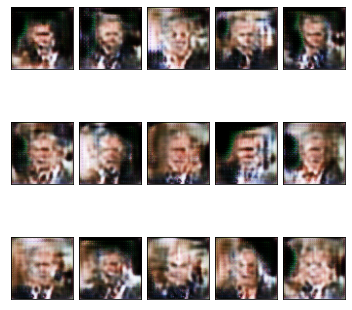

In [8]:
# Plot images from best or last model
if os.path.isfile(f'{checkpoint_file}.pt'):
    gen = torch.load(f'{checkpoint_file}.pt', map_location=device)
print('*** Images Generated from best model:')
samples = gen["model"].sample(n=15, with_grad=False).cpu()
fig, _ = plot.tensors_as_images(samples, nrows=3, figsize=(6,6))

In [9]:
# save images
from torchvision.utils import save_image

N = 15
baseName = "samples/sngan/Sample_SNGAN_"
for i in range(N):
    save_image(samples[i], baseName+str(i)+".png")

In [10]:
## inception test TODO
from inception_s.inception_score import inception_score

mean, std = inception_score(samples, cuda=device,batch_size=5,resize=True, splits=1)
print("mean:", mean)
print("std:", std)
file = open("temp/stat.txt", 'a')
file.write(str(mean)+' '+str(std) + '\n')
file.close()

mean: 1.979821927840773
std: 0.0


In [11]:
# WGAN

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload
Using device: cuda
File /home/tok/.pytorch-datasets/lfw-bush.zip exists, skipping download.
Extracting /home/tok/.pytorch-datasets/lfw-bush.zip...
Extracted 531 to /home/tok/.pytorch-datasets/lfw/George_W_Bush
{'batch_size': 32, 'z_dim': 64, 'data_label': 1, 'label_noise': 0.5, 'discriminator_optimizer': {'type': 'RMSprop', 'lr': 0.0007}, 'generator_optimizer': {'type': 'RMSprop', 'lr': 7e-05}}
--- EPOCH 1/100 ---
100%|██████████| 17/17 [00:05<00:00,  2.91it/s]
Discriminator loss: -3.6993377226240494
Generator loss:     0.5103218502858106
Saved checkpoint.


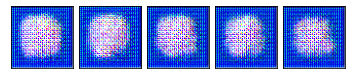

--- EPOCH 2/100 ---
100%|██████████| 17/17 [00:05<00:00,  3.01it/s]
Discriminator loss: -4.100869964150822
Generator loss:     3.2836091658648323


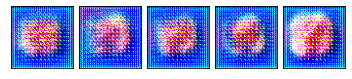

--- EPOCH 3/100 ---
100%|██████████| 17/17 [00:05<00:00,  3.01it/s]
Discriminator loss: -3.8500450972248528
Generator loss:     2.891324092360104
Saved checkpoint.


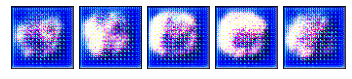

--- EPOCH 4/100 ---
100%|██████████| 17/17 [00:05<00:00,  3.02it/s]
Discriminator loss: -2.026919010807486
Generator loss:     1.0718079445993198


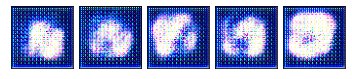

--- EPOCH 5/100 ---
100%|██████████| 17/17 [00:05<00:00,  3.00it/s]
Discriminator loss: -2.6851833497776703
Generator loss:     2.4504307788961075


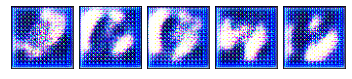

--- EPOCH 6/100 ---
100%|██████████| 17/17 [00:05<00:00,  3.00it/s]
Discriminator loss: -3.453264741336598
Generator loss:     1.7499244984458475
Saved checkpoint.


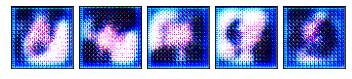

--- EPOCH 7/100 ---
100%|██████████| 17/17 [00:05<00:00,  2.98it/s]
Discriminator loss: -3.3208578193888947
Generator loss:     1.0484740159967367
Saved checkpoint.


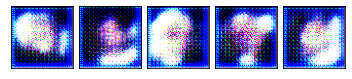

--- EPOCH 8/100 ---
100%|██████████| 17/17 [00:05<00:00,  2.99it/s]
Discriminator loss: -1.749423104173997
Generator loss:     -0.5530798575457405
Saved checkpoint.


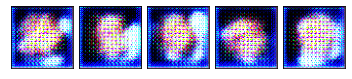

--- EPOCH 9/100 ---
100%|██████████| 17/17 [00:05<00:00,  3.02it/s]
Discriminator loss: -1.7863188350901884
Generator loss:     1.0861950442194939


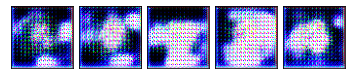

--- EPOCH 10/100 ---
100%|██████████| 17/17 [00:05<00:00,  3.02it/s]
Discriminator loss: -3.1819145118488983
Generator loss:     1.726096749305725
Saved checkpoint.


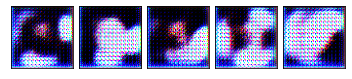

--- EPOCH 11/100 ---
100%|██████████| 17/17 [00:05<00:00,  3.02it/s]
Discriminator loss: -4.309170835158405
Generator loss:     1.4257287733695085
Saved checkpoint.


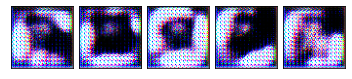

--- EPOCH 12/100 ---
100%|██████████| 17/17 [00:05<00:00,  3.02it/s]
Discriminator loss: -3.1407818163142487
Generator loss:     -0.2834518472937977
Saved checkpoint.


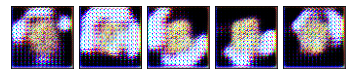

--- EPOCH 13/100 ---
100%|██████████| 17/17 [00:05<00:00,  3.03it/s]
Discriminator loss: -1.8783265913234037
Generator loss:     -0.5069068424841937


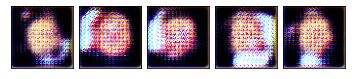

--- EPOCH 14/100 ---
100%|██████████| 17/17 [00:05<00:00,  2.98it/s]
Discriminator loss: -2.5031415574690876
Generator loss:     2.5822532439933106


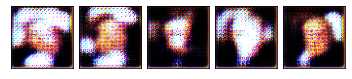

--- EPOCH 15/100 ---
100%|██████████| 17/17 [00:05<00:00,  2.99it/s]
Discriminator loss: -2.58782800506143
Generator loss:     2.100717468515915
Saved checkpoint.


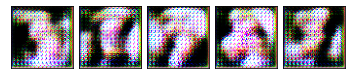

--- EPOCH 16/100 ---
100%|██████████| 17/17 [00:05<00:00,  3.01it/s]
Discriminator loss: -3.750835993710686
Generator loss:     2.1961980663678227
Saved checkpoint.


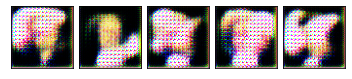

--- EPOCH 17/100 ---
100%|██████████| 17/17 [00:05<00:00,  3.01it/s]
Discriminator loss: -4.0074250137104706
Generator loss:     1.7015307089861702
Saved checkpoint.


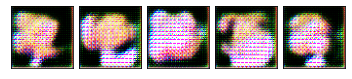

--- EPOCH 18/100 ---
100%|██████████| 17/17 [00:05<00:00,  3.03it/s]
Discriminator loss: -4.170151752584121
Generator loss:     1.8213818511542152
Saved checkpoint.


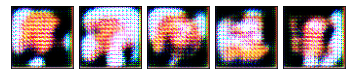

--- EPOCH 19/100 ---
100%|██████████| 17/17 [00:05<00:00,  3.01it/s]
Discriminator loss: -3.802012731047238
Generator loss:     2.421561160508324


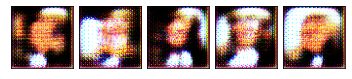

--- EPOCH 20/100 ---
100%|██████████| 17/17 [00:05<00:00,  3.00it/s]
Discriminator loss: -3.5634712471681484
Generator loss:     2.965434300768025


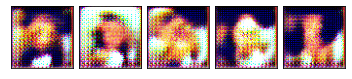

--- EPOCH 21/100 ---
100%|██████████| 17/17 [00:05<00:00,  3.01it/s]
Discriminator loss: -3.9032157449161304
Generator loss:     2.9247401836602127
Saved checkpoint.


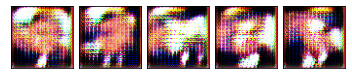

--- EPOCH 22/100 ---
100%|██████████| 17/17 [00:05<00:00,  2.98it/s]
Discriminator loss: -3.3776818303500904
Generator loss:     2.6810456575716244


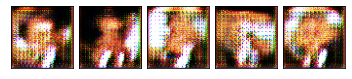

--- EPOCH 23/100 ---
100%|██████████| 17/17 [00:05<00:00,  3.00it/s]
Discriminator loss: -3.0630020394044766
Generator loss:     2.8739752348731544


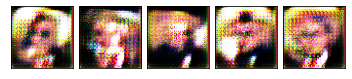

--- EPOCH 24/100 ---
100%|██████████| 17/17 [00:05<00:00,  3.00it/s]
Discriminator loss: -2.896123914157643
Generator loss:     3.159185979296179


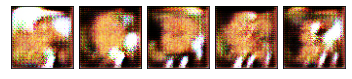

--- EPOCH 25/100 ---
100%|██████████| 17/17 [00:05<00:00,  3.02it/s]
Discriminator loss: -2.622433487106772
Generator loss:     3.1386427248225495


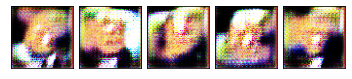

--- EPOCH 26/100 ---
100%|██████████| 17/17 [00:05<00:00,  3.01it/s]
Discriminator loss: -2.8123071544310627
Generator loss:     3.1462543466511894
Saved checkpoint.


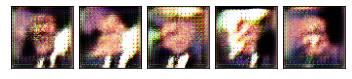

--- EPOCH 27/100 ---
100%|██████████| 17/17 [00:05<00:00,  3.03it/s]
Discriminator loss: -2.2239076144555034
Generator loss:     3.528171181678772


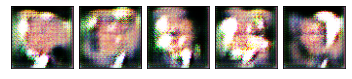

--- EPOCH 28/100 ---
100%|██████████| 17/17 [00:05<00:00,  3.01it/s]
Discriminator loss: -2.469083372284384
Generator loss:     3.3619418144226074
Saved checkpoint.


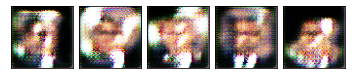

--- EPOCH 29/100 ---
100%|██████████| 17/17 [00:05<00:00,  3.03it/s]
Discriminator loss: -3.009355474920834
Generator loss:     2.7846098892829
Saved checkpoint.


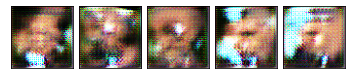

--- EPOCH 30/100 ---
100%|██████████| 17/17 [00:05<00:00,  3.02it/s]
Discriminator loss: -3.1456923064063576
Generator loss:     3.0365618958192715


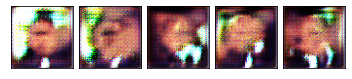

--- EPOCH 31/100 ---
100%|██████████| 17/17 [00:05<00:00,  3.00it/s]
Discriminator loss: -2.2510024239035213
Generator loss:     3.29743489447762


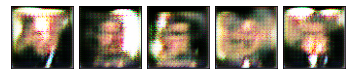

--- EPOCH 32/100 ---
100%|██████████| 17/17 [00:05<00:00,  3.00it/s]
Discriminator loss: -1.9415209573857926
Generator loss:     2.9314760004772857
Saved checkpoint.


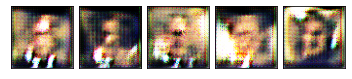

--- EPOCH 33/100 ---
100%|██████████| 17/17 [00:05<00:00,  2.99it/s]
Discriminator loss: -2.1109110011773953
Generator loss:     3.3374942120383766


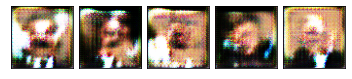

--- EPOCH 34/100 ---
100%|██████████| 17/17 [00:05<00:00,  3.00it/s]
Discriminator loss: -2.167759797152351
Generator loss:     3.617301176576053


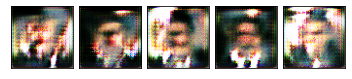

--- EPOCH 35/100 ---
100%|██████████| 17/17 [00:05<00:00,  3.02it/s]
Discriminator loss: -2.066769908456241
Generator loss:     3.4695054362801945
Saved checkpoint.


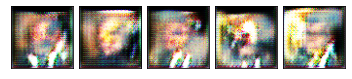

--- EPOCH 36/100 ---
100%|██████████| 17/17 [00:05<00:00,  3.02it/s]
Discriminator loss: -2.1579140179297505
Generator loss:     3.630127794602338


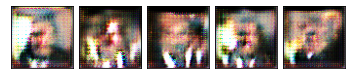

--- EPOCH 37/100 ---
100%|██████████| 17/17 [00:05<00:00,  3.01it/s]
Discriminator loss: -2.4520108769921696
Generator loss:     4.018316900028902


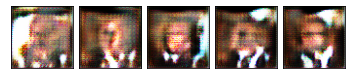

--- EPOCH 38/100 ---
100%|██████████| 17/17 [00:05<00:00,  3.03it/s]
Discriminator loss: -2.392163574695587
Generator loss:     3.553499432171092
Saved checkpoint.


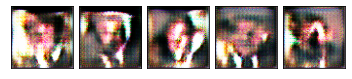

--- EPOCH 39/100 ---
100%|██████████| 17/17 [00:05<00:00,  3.02it/s]
Discriminator loss: -2.1168469611336205
Generator loss:     3.8960090735379387


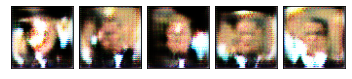

--- EPOCH 40/100 ---
100%|██████████| 17/17 [00:05<00:00,  3.03it/s]
Discriminator loss: -2.359476040391361
Generator loss:     3.953225479406469
Saved checkpoint.


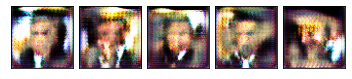

--- EPOCH 41/100 ---
100%|██████████| 17/17 [00:05<00:00,  2.99it/s]
Discriminator loss: -2.413145380861619
Generator loss:     3.4573850982329426
Saved checkpoint.


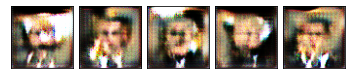

--- EPOCH 42/100 ---
100%|██████████| 17/17 [00:05<00:00,  3.00it/s]
Discriminator loss: -2.2120565596748802
Generator loss:     3.546104108586031


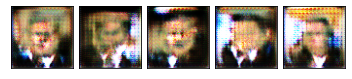

--- EPOCH 43/100 ---
100%|██████████| 17/17 [00:05<00:00,  2.97it/s]
Discriminator loss: -2.4546702959958244
Generator loss:     3.8239957585054287


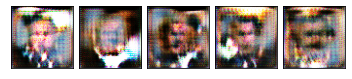

--- EPOCH 44/100 ---
100%|██████████| 17/17 [00:05<00:00,  3.00it/s]
Discriminator loss: -2.9897668221417595
Generator loss:     3.491819171344533
Saved checkpoint.


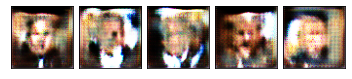

--- EPOCH 45/100 ---
100%|██████████| 17/17 [00:05<00:00,  3.03it/s]
Discriminator loss: -2.5857278178719914
Generator loss:     3.8959793834125294


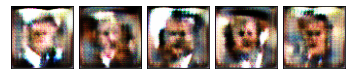

--- EPOCH 46/100 ---
100%|██████████| 17/17 [00:05<00:00,  3.00it/s]
Discriminator loss: -2.721164352753583
Generator loss:     4.0900810536216285


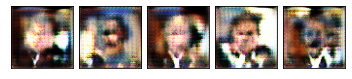

--- EPOCH 47/100 ---
100%|██████████| 17/17 [00:05<00:00,  3.01it/s]
Discriminator loss: -2.5710690652622894
Generator loss:     3.4061729031450607
Saved checkpoint.


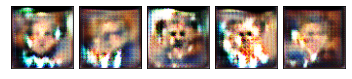

--- EPOCH 48/100 ---
100%|██████████| 17/17 [00:05<00:00,  3.02it/s]
Discriminator loss: -2.853778832099017
Generator loss:     3.69057157460381


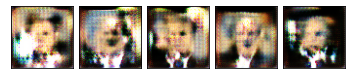

--- EPOCH 49/100 ---
100%|██████████| 17/17 [00:05<00:00,  3.02it/s]
Discriminator loss: -2.6193807405584
Generator loss:     4.392209487802842


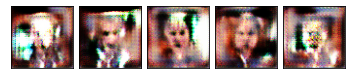

--- EPOCH 50/100 ---
100%|██████████| 17/17 [00:05<00:00,  2.99it/s]
Discriminator loss: -3.101173793568331
Generator loss:     4.575088529025807
Saved checkpoint.


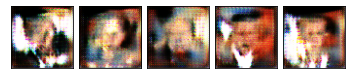

--- EPOCH 51/100 ---
100%|██████████| 17/17 [00:05<00:00,  3.03it/s]
Discriminator loss: -2.5817407720229206
Generator loss:     3.1393146024030796
Saved checkpoint.


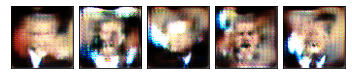

--- EPOCH 52/100 ---
100%|██████████| 17/17 [00:05<00:00,  2.98it/s]
Discriminator loss: -3.00306541779462
Generator loss:     4.526399556328268


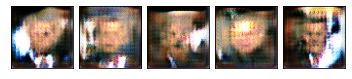

--- EPOCH 53/100 ---
100%|██████████| 17/17 [00:05<00:00,  3.02it/s]
Discriminator loss: -2.5875916901756737
Generator loss:     4.041949510574341
Saved checkpoint.


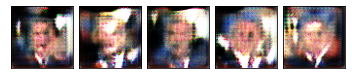

--- EPOCH 54/100 ---
100%|██████████| 17/17 [00:05<00:00,  3.00it/s]
Discriminator loss: -2.6109000514535343
Generator loss:     4.2910113474901985


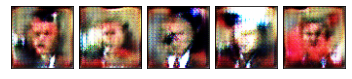

--- EPOCH 55/100 ---
100%|██████████| 17/17 [00:05<00:00,  3.03it/s]
Discriminator loss: -2.759245185291066
Generator loss:     3.790979778065401
Saved checkpoint.


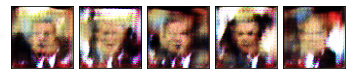

--- EPOCH 56/100 ---
100%|██████████| 17/17 [00:05<00:00,  3.03it/s]
Discriminator loss: -2.5005103700301228
Generator loss:     4.27446320477654


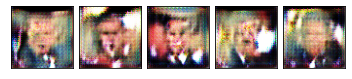

--- EPOCH 57/100 ---
100%|██████████| 17/17 [00:05<00:00,  3.00it/s]
Discriminator loss: -2.5446911278892967
Generator loss:     4.767575235927806


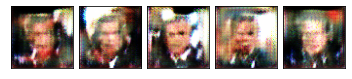

--- EPOCH 58/100 ---
100%|██████████| 17/17 [00:05<00:00,  2.98it/s]
Discriminator loss: -2.3853259928086223
Generator loss:     4.884328154956593


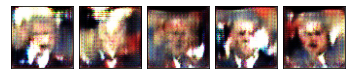

--- EPOCH 59/100 ---
100%|██████████| 17/17 [00:05<00:00,  3.00it/s]
Discriminator loss: -2.609143474522759
Generator loss:     4.58920492144192
Saved checkpoint.


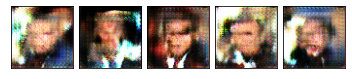

--- EPOCH 60/100 ---
100%|██████████| 17/17 [00:05<00:00,  2.99it/s]
Discriminator loss: -2.290728337624494
Generator loss:     4.1567002324497
Saved checkpoint.


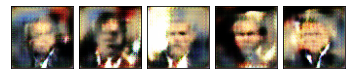

--- EPOCH 61/100 ---
100%|██████████| 17/17 [00:05<00:00,  3.02it/s]
Discriminator loss: -2.4129291983211743
Generator loss:     4.710043388254502


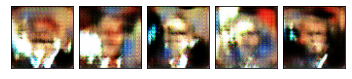

--- EPOCH 62/100 ---
100%|██████████| 17/17 [00:05<00:00,  3.04it/s]
Discriminator loss: -2.1271025503382965
Generator loss:     3.361492858213537
Saved checkpoint.


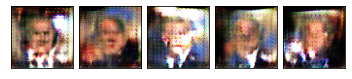

--- EPOCH 63/100 ---
100%|██████████| 17/17 [00:05<00:00,  3.02it/s]
Discriminator loss: -2.016631280674654
Generator loss:     3.882451057434082


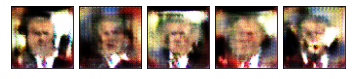

--- EPOCH 64/100 ---
100%|██████████| 17/17 [00:05<00:00,  3.02it/s]
Discriminator loss: -2.1655769067652084
Generator loss:     3.8582787794225357
Saved checkpoint.


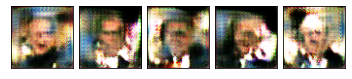

--- EPOCH 65/100 ---
100%|██████████| 17/17 [00:05<00:00,  3.02it/s]
Discriminator loss: -1.9449580346836763
Generator loss:     3.4359483438379623
Saved checkpoint.


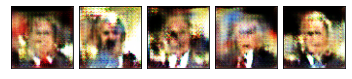

--- EPOCH 66/100 ---
100%|██████████| 17/17 [00:05<00:00,  3.01it/s]
Discriminator loss: -2.115052517722635
Generator loss:     3.407041647854973
Saved checkpoint.


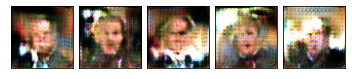

--- EPOCH 67/100 ---
100%|██████████| 17/17 [00:05<00:00,  3.00it/s]
Discriminator loss: -2.1396012656828938
Generator loss:     3.4703429726993336


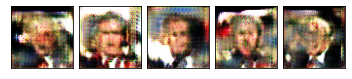

--- EPOCH 68/100 ---
100%|██████████| 17/17 [00:05<00:00,  3.03it/s]
Discriminator loss: -2.1307861664715935
Generator loss:     3.730786884532255


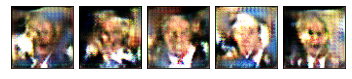

--- EPOCH 69/100 ---
100%|██████████| 17/17 [00:05<00:00,  3.00it/s]
Discriminator loss: -2.05259968252743
Generator loss:     3.854662334217745


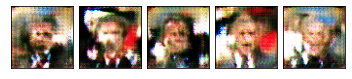

--- EPOCH 70/100 ---
100%|██████████| 17/17 [00:05<00:00,  3.03it/s]
Discriminator loss: -1.9460939098806942
Generator loss:     3.7803811886731316


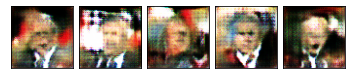

--- EPOCH 71/100 ---
100%|██████████| 17/17 [00:05<00:00,  3.02it/s]
Discriminator loss: -1.7476610576405245
Generator loss:     3.0250276186886955
Saved checkpoint.


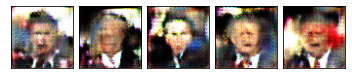

--- EPOCH 72/100 ---
100%|██████████| 17/17 [00:05<00:00,  3.01it/s]
Discriminator loss: -1.9108871081296135
Generator loss:     3.3097292956183937


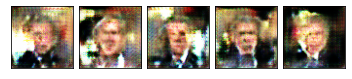

--- EPOCH 73/100 ---
100%|██████████| 17/17 [00:05<00:00,  3.03it/s]
Discriminator loss: -1.7669656837687773
Generator loss:     3.6191149318919464


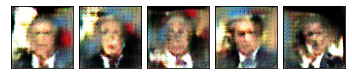

--- EPOCH 74/100 ---
100%|██████████| 17/17 [00:05<00:00,  2.98it/s]
Discriminator loss: -1.720696764833787
Generator loss:     3.633884969879599


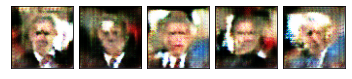

--- EPOCH 75/100 ---
100%|██████████| 17/17 [00:05<00:00,  2.99it/s]
Discriminator loss: -1.9212332963943481
Generator loss:     3.326643705368042
Saved checkpoint.


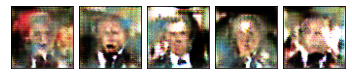

--- EPOCH 76/100 ---
100%|██████████| 17/17 [00:05<00:00,  3.01it/s]
Discriminator loss: -1.7493744387346155
Generator loss:     2.874177512000589
Saved checkpoint.


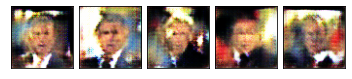

--- EPOCH 77/100 ---
100%|██████████| 17/17 [00:05<00:00,  3.03it/s]
Discriminator loss: -1.8312759118921615
Generator loss:     3.1820021376890293


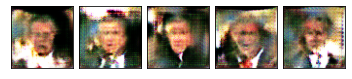

--- EPOCH 78/100 ---
100%|██████████| 17/17 [00:05<00:00,  2.97it/s]
Discriminator loss: -1.4423222331439747
Generator loss:     2.6737852026434505
Saved checkpoint.


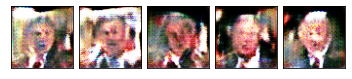

--- EPOCH 79/100 ---
100%|██████████| 17/17 [00:05<00:00,  3.04it/s]
Discriminator loss: -1.6813940931768978
Generator loss:     3.00791530048146


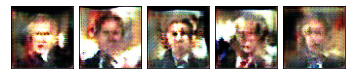

--- EPOCH 80/100 ---
100%|██████████| 17/17 [00:05<00:00,  3.02it/s]
Discriminator loss: -1.6247416384079878
Generator loss:     2.695067952660953
Saved checkpoint.


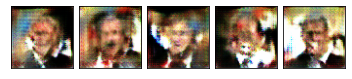

--- EPOCH 81/100 ---
100%|██████████| 17/17 [00:05<00:00,  3.02it/s]
Discriminator loss: -1.529836283010595
Generator loss:     2.6612736337325154


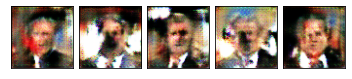

--- EPOCH 82/100 ---
100%|██████████| 17/17 [00:05<00:00,  3.04it/s]
Discriminator loss: -1.5951641447403853
Generator loss:     2.365249423419728
Saved checkpoint.


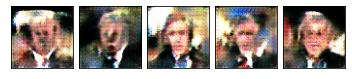

--- EPOCH 83/100 ---
100%|██████████| 17/17 [00:05<00:00,  3.01it/s]
Discriminator loss: -1.7197084426879883
Generator loss:     2.4671120643615723
Saved checkpoint.


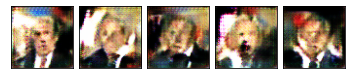

--- EPOCH 84/100 ---
100%|██████████| 17/17 [00:05<00:00,  3.00it/s]
Discriminator loss: -1.462186196271111
Generator loss:     2.8486409678178677


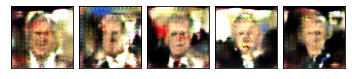

--- EPOCH 85/100 ---
100%|██████████| 17/17 [00:05<00:00,  3.01it/s]
Discriminator loss: -1.509872639880461
Generator loss:     2.642330148640801
Saved checkpoint.


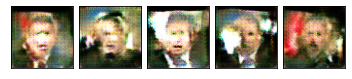

--- EPOCH 86/100 ---
100%|██████████| 17/17 [00:05<00:00,  3.01it/s]
Discriminator loss: -1.5473202817580278
Generator loss:     2.4880869037964763
Saved checkpoint.


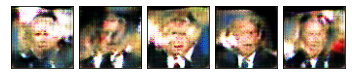

--- EPOCH 87/100 ---
100%|██████████| 17/17 [00:05<00:00,  2.99it/s]
Discriminator loss: -1.16223123143701
Generator loss:     2.713184868588167


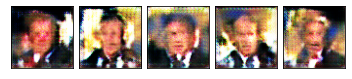

--- EPOCH 88/100 ---
100%|██████████| 17/17 [00:05<00:00,  3.01it/s]
Discriminator loss: -1.323263357667362
Generator loss:     2.453719307394589
Saved checkpoint.


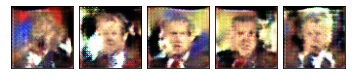

--- EPOCH 89/100 ---
100%|██████████| 17/17 [00:05<00:00,  3.01it/s]
Discriminator loss: -1.1687993933172787
Generator loss:     2.295333245221306
Saved checkpoint.


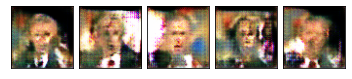

--- EPOCH 90/100 ---
100%|██████████| 17/17 [00:05<00:00,  3.02it/s]
Discriminator loss: -1.2497843363705803
Generator loss:     2.489263380275053


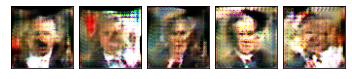

--- EPOCH 91/100 ---
100%|██████████| 17/17 [00:05<00:00,  3.02it/s]
Discriminator loss: -1.2637151690090405
Generator loss:     2.227234959602356
Saved checkpoint.


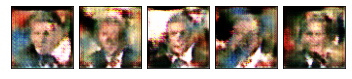

--- EPOCH 92/100 ---
100%|██████████| 17/17 [00:05<00:00,  3.02it/s]
Discriminator loss: -1.2592359711142147
Generator loss:     2.698626013363109


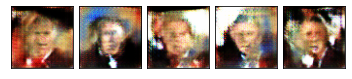

--- EPOCH 93/100 ---
100%|██████████| 17/17 [00:05<00:00,  3.00it/s]
Discriminator loss: -1.197981077082017
Generator loss:     2.445145936573253
Saved checkpoint.


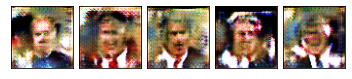

--- EPOCH 94/100 ---
100%|██████████| 17/17 [00:05<00:00,  3.02it/s]
Discriminator loss: -1.1368618642582613
Generator loss:     2.4654788269716152


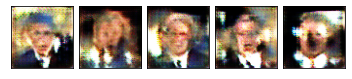

--- EPOCH 95/100 ---
100%|██████████| 17/17 [00:05<00:00,  2.98it/s]
Discriminator loss: -1.0622238411622889
Generator loss:     2.1210125474368824
Saved checkpoint.


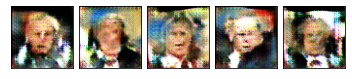

--- EPOCH 96/100 ---
100%|██████████| 17/17 [00:05<00:00,  2.97it/s]
Discriminator loss: -1.2011851352803848
Generator loss:     2.1398122661253987
Saved checkpoint.


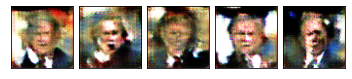

--- EPOCH 97/100 ---
100%|██████████| 17/17 [00:05<00:00,  3.04it/s]
Discriminator loss: -1.1194463091738083
Generator loss:     1.7752549437915577
Saved checkpoint.


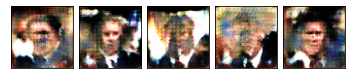

--- EPOCH 98/100 ---
100%|██████████| 17/17 [00:05<00:00,  2.91it/s]
Discriminator loss: -0.9397198452669031
Generator loss:     1.6615688134642208


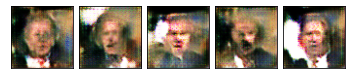

--- EPOCH 99/100 ---
100%|██████████| 17/17 [00:05<00:00,  3.04it/s]
Discriminator loss: -0.8924037744017208
Generator loss:     1.687958636704613


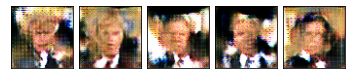

--- EPOCH 100/100 ---
100%|██████████| 17/17 [00:05<00:00,  2.97it/s]
Discriminator loss: -0.7786347603096682
Generator loss:     1.0336217599756576
Saved checkpoint.


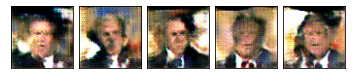

In [12]:
import unittest
import os
import sys
import pathlib
import urllib
import shutil
import re
import zipfile

import numpy as np
import torch
import matplotlib.pyplot as plt

%load_ext autoreload
%autoreload 2

test = unittest.TestCase()
plt.rcParams.update({'font.size': 12})
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
print('Using device:', device)


import project.cs236781.plot as plot
import project.cs236781.download
from project.hw3.answers import PART3_CUSTOM_DATA_URL as CUSTOM_DATA_URL

DATA_DIR = pathlib.Path.home().joinpath('.pytorch-datasets')
if CUSTOM_DATA_URL is None:
    DATA_URL = 'http://vis-www.cs.umass.edu/lfw/lfw-bush.zip'
else:
    DATA_URL = CUSTOM_DATA_URL

_, dataset_dir = project.cs236781.download.download_data(out_path=DATA_DIR, url=DATA_URL, extract=True, force=False)


import torchvision.transforms as T
from torchvision.datasets import ImageFolder

im_size = 64
tf = T.Compose([
    # Resize to constant spatial dimensions
    T.Resize((im_size, im_size)),
    # PIL.Image -> torch.Tensor
    T.ToTensor(),
    # Dynamic range [0,1] -> [-1, 1]
    T.Normalize(mean=(.5,.5,.5), std=(.5,.5,.5)),
])

ds_gwb = ImageFolder(os.path.dirname(dataset_dir), tf)

# _ = plot.dataset_first_n(ds_gwb, 50, figsize=(15,10), nrows=5)
# print(f'Found {len(ds_gwb)} images in dataset folder.')

x0, y0 = ds_gwb[0]
x0 = x0.unsqueeze(0).to(device)
# print(x0.shape)

test.assertSequenceEqual(x0.shape, (1, 3, im_size, im_size))


import project.hw3.gan_w as gan

dsc = gan.Discriminator(in_size=x0[0].shape).to(device)
# print(dsc)

d0 = dsc(x0)
# print(d0.shape)

test.assertSequenceEqual(d0.shape, (1,1))


z_dim = 128
gen = gan.Generator(z_dim, 4).to(device)
# print(gen)

z = torch.randn(1, z_dim).to(device)
xr = gen(z)
# print(xr.shape)

test.assertSequenceEqual(x0.shape, xr.shape)


from project.hw3.gan_w import discriminator_loss_fn
torch.manual_seed(42)

y_data = torch.rand(10) * 10
y_generated = torch.rand(10) * 10

loss = discriminator_loss_fn(y_data, y_generated, data_label=1, label_noise=0.3)
# print(loss)

# test.assertAlmostEqual(loss.item(), 6.4808731, delta=1e-5)


from project.hw3.gan_w import generator_loss_fn
torch.manual_seed(42)

y_generated = torch.rand(20) * 10

loss = generator_loss_fn(y_generated, data_label=1)
# print(loss)

# test.assertAlmostEqual(loss.item(), 0.0222969, delta=1e-3)


samples = gen.sample(5, with_grad=False)
test.assertSequenceEqual(samples.shape, (5, *x0.shape[1:]))
test.assertIsNone(samples.grad_fn)
# _ = plot.tensors_as_images(samples.cpu())

samples = gen.sample(5, with_grad=True)
test.assertSequenceEqual(samples.shape, (5, *x0.shape[1:]))
test.assertIsNotNone(samples.grad_fn)


import torch.optim as optim
from torch.utils.data import DataLoader
from project.hw3.answers import part3_gan_hyperparams_wgan

torch.manual_seed(42)

# Hyperparams
hp = part3_gan_hyperparams_wgan()
batch_size = hp['batch_size']
z_dim = hp['z_dim']

# Data
dl_train = DataLoader(ds_gwb, batch_size, shuffle=True)
im_size = ds_gwb[0][0].shape

# Model
dsc = gan.Discriminator(im_size).to(device)
gen = gan.Generator(z_dim, featuremap_size=4).to(device)

# Optimizer
def create_optimizer(model_params, opt_params):
    opt_params = opt_params.copy()
    optimizer_type = opt_params['type']
    opt_params.pop('type')
    return optim.__dict__[optimizer_type](model_params, **opt_params)
dsc_optimizer = create_optimizer(dsc.parameters(), hp['discriminator_optimizer'])
gen_optimizer = create_optimizer(gen.parameters(), hp['generator_optimizer'])

# Loss
def dsc_loss_fn(y_data, y_generated):
    return gan.discriminator_loss_fn(y_data, y_generated, hp['data_label'], hp['label_noise'])

def gen_loss_fn(y_generated):
    return gan.generator_loss_fn(y_generated, hp['data_label'])

# Training
checkpoint_file = 'checkpoints/gan_wgan'
checkpoint_file_final = f'{checkpoint_file}_final'
if os.path.isfile(f'{checkpoint_file}.pt'):
    os.remove(f'{checkpoint_file}.pt')

# Show hypers
print(hp)

import IPython.display
import tqdm
from project.hw3.gan_w import train_batch, save_checkpoint

num_epochs = 100

if os.path.isfile(f'{checkpoint_file_final}.pt'):
    print(f'*** Loading final checkpoint file {checkpoint_file_final} instead of training')
    num_epochs = 0
    gen = torch.load(f'{checkpoint_file_final}.pt', map_location=device)
    checkpoint_file = checkpoint_file_final

try:
    dsc_avg_losses, gen_avg_losses = [], []
    for epoch_idx in range(num_epochs):
        # We'll accumulate batch losses and show an average once per epoch.
        dsc_losses, gen_losses = [], []
        print(f'--- EPOCH {epoch_idx+1}/{num_epochs} ---')

        with tqdm.tqdm(total=len(dl_train.batch_sampler), file=sys.stdout) as pbar:
            for batch_idx, (x_data, _) in enumerate(dl_train):
                x_data = x_data.to(device)
                dsc_loss, gen_loss = train_batch(
                    dsc, gen,
                    dsc_loss_fn, gen_loss_fn,
                    dsc_optimizer, gen_optimizer,
                    x_data)
                dsc_losses.append(dsc_loss)
                gen_losses.append(gen_loss)
                pbar.update()

        dsc_avg_losses.append(np.mean(dsc_losses))
        gen_avg_losses.append(np.mean(gen_losses))
        print(f'Discriminator loss: {dsc_avg_losses[-1]}')
        print(f'Generator loss:     {gen_avg_losses[-1]}')
        
        if save_checkpoint(gen, dsc_avg_losses, gen_avg_losses, checkpoint_file):
            print(f'Saved checkpoint.')
            

        samples = gen.sample(5, with_grad=False)
        fig, _ = plot.tensors_as_images(samples.cpu(), figsize=(6,2))
        IPython.display.display(fig)
        plt.close(fig)
except KeyboardInterrupt as e:
    print('\n *** Training interrupted by user')


In [13]:
# Plot images from best or last model
if os.path.isfile(f'{checkpoint_file}.pt'):
    gen = torch.load(f'{checkpoint_file}.pt', map_location=device)
print('*** Images Generated from best model:')
samples = gen.sample(n=15, with_grad=False).cpu()
fig, _ = plot.tensors_as_images(samples, nrows=3, figsize=(6,6))

*** Images Generated from best model:


AttributeError: 'dict' object has no attribute 'sample'

In [ ]:
## inception test TODO
from inception_s.inception_score import inception_score

mean, std = inception_score(samples, cuda=device,batch_size=5,resize=True, splits=1)
print("mean:", mean)
print("std:", std)
file = open("temp/stat.txt", 'a')
file.write(str(mean)+' '+str(std) + '\n')
file.close()

In [ ]:
# save images
from torchvision.utils import save_image

N = 15
baseName = "samples/wgan/Sample_WGAN_"
for i in range(N):
    save_image(samples[i], baseName+str(i)+".png")

In [ ]:
import cv2
# TODO put the files in project (change the code acordingly) (V)
N = 15

# Show results (images) from each model
mean_figure, mean_axes = plt.subplots(nrows=3, ncols=5)
mean_axes = mean_axes.reshape(-1)
mean_figure.suptitle('GAN best results')
for i in range(N):
    img = cv2.imread('samples/vanilla/Sample_GAN_Vanilla_'+str(i)+'.png')
    mean_axes[i].imshow(img)
plt.show()
plt.clf()

mean_figure, mean_axes = plt.subplots(nrows=3, ncols=5)
mean_axes = mean_axes.reshape(-1)
mean_figure.suptitle('SNGAN best results')
for i in range(N):
    img = cv2.imread('samples/sngan/Sample_SNGAN_'+str(i)+'.png')
    mean_axes[i].imshow(img)
plt.show()
plt.clf()

mean_figure, mean_axes = plt.subplots(nrows=3, ncols=5)
mean_axes = mean_axes.reshape(-1)
mean_figure.suptitle('WGAN best results')
for i in range(N):
    img = cv2.imread('samples/wgan/Sample_WGAN_'+str(i)+'.png')
    mean_axes[i].imshow(img)
plt.show()
plt.clf()
        
# read mean, std from files:
file = open("temp/stat.txt", 'r')
stat = file.read()

stat_list = stat.split('\n')
stat_gan, stat_sngan, stat_wgan, _ = stat_list
mean_gan, std_gan = stat_gan.split(' ')
mean_sngan, std_sngan = stat_sngan.split(' ')
mean_wgan, std_wgan = stat_wgan.split(' ')
file.close()


# Show results (inception test) from each model
# x-coordinates of left sides of bars 
  
# heights of bars
mean = [float(mean_gan), float(mean_sngan), float(mean_wgan)]


# labels for bars
model_label = ['gan', 'sngan', 'wgan']

left = [1, 2, 3]

# plotting a bar chart
plt.bar(left, height = mean, tick_label = model_label,
        width = 0.8, color = ['red', 'green', 'blue'])
  
# naming the x-axis
plt.xlabel('model')
# naming the y-axis
plt.ylabel('test mean')
# plot title
plt.title('inception test scores')
  
# function to show the plot
plt.show()


print("gan std = " + std_gan)
print("sngan std = " + std_sngan)
print("wgan std = " + std_wgan)

# what you implemented and how
print("We implemented simple vanilla gan that gave as nice results.")
print("Than we improbed our model by inserting SOTA improvments to the models: SNGAN and WGAN.")

# external code
#TODO

# The structure of the code and how to run it.. Models are in bla bla.. hyperparams...  how to run..? put the code from the notebook
#TODO

# Why we got this result??? ask for help!!!!!!!!!

# compare the models
print("One of the drawbacks of gan is the instability of the training. The SN-gan tries to solve this problem by weight normalization technique in the discriminator.")
print("The spectral normalization normalizes the layers in the neural network. This ensures stability in the learning of the discriminator.")
print("We can see both in the images generated and in the inception test that the sngan outperformes gan.")
print("Wgan is another improvment fo the gan.")